In [ ]:
# import the libraries

import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm import tqdm
import matplotlib.pyplot as plt

In [ ]:
# visualization function
def  show(tensor, ch=1, size=(28,28), num=16):

  #tensor: 128 x 784
  data=tensor.detach().cpu().view(-1,ch,*size)
  grid = make_grid(data[:num], nrow=4).permute(1,2,0)
  plt.imshow(grid)
  plt.show()

In [ ]:
# setup of the main parameters and hyperparameter
epochs = 200
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = 'cuda'

dataloader = DataLoader(MNIST('.', download=True, transform=transforms.ToTensor()), shuffle=True, batch_size=bs)

# number of steps = 60000 / 128 = 468.75

In [ ]:
from torch.nn.modules.batchnorm import BatchNorm1d
# declare our models

#Generator
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace=True)
  )

class Generator(nn.Module):
  def __init__(self, z_dim=64, i_dim=784, h_dim=128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim),
        genBlock(h_dim, h_dim*2),
        genBlock(h_dim*2, h_dim*4),
        genBlock(h_dim*4, h_dim*8),
        nn.Linear(h_dim*8, i_dim),
        nn.Sigmoid(),
    )

  def forward(self, noise):
      return self.gen(noise)

def gen_noise(number, z_dim):
  return torch.randn(number, z_dim).to(device)

# Discriminator
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):
  def __init__(self, i_dim=784, h_dim=256):
    super().__init__()
    self.disc=nn.Sequential(
        discBlock(i_dim, h_dim*4),
        discBlock(h_dim*4, h_dim*2),
        discBlock(h_dim*2, h_dim),
        nn.Linear(h_dim, 1)
    )

  def forward(self, image):
      return self.disc(image)

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [ ]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([4, 0, 0, 7, 5, 6, 5, 7, 4, 7])


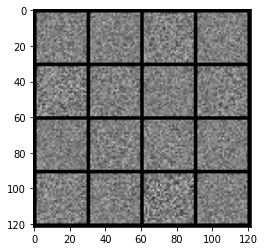

In [ ]:
x,y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

In [ ]:
# Calculating the loss

# Generator loss

def calc_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  pred = disc(fake)
  targets = torch.ones_like(pred)
  gen_loss = loss_func(pred, targets)

  return gen_loss

def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)

  disc_fake = disc(fake.detach())
  disc_fake_targets = torch.zeros_like(disc_fake)
  disc_fake_loss = loss_func(disc_fake, disc_fake_targets)

  disc_real = disc(real)
  disc_real_targets = torch.ones_like(disc_real)
  disc_real_loss = loss_func(disc_real, disc_real_targets)

  disc_loss = (disc_fake_loss + disc_real_loss)/2

  return disc_loss

 64%|██████▍   | 299/469 [00:05<00:03, 52.51it/s]

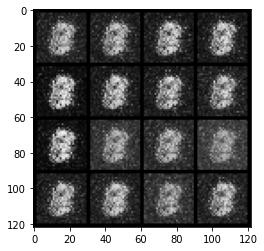

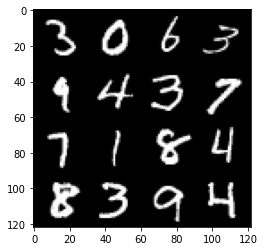

 66%|██████▌   | 310/469 [00:06<00:05, 30.46it/s]

0: step 300 / Gen loss: 1.8565710037946703 / disc_loss: 0.33356228694319695


 27%|██▋       | 128/469 [00:03<00:08, 41.23it/s]

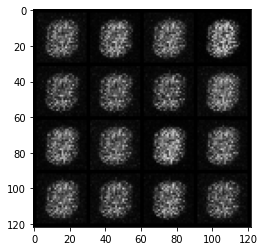

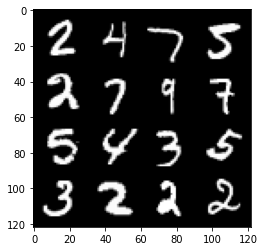

 29%|██▉       | 138/469 [00:03<00:11, 29.88it/s]

1: step 600 / Gen loss: 3.31758918762207 / disc_loss: 0.11935393107434111


 92%|█████████▏| 430/469 [00:09<00:00, 51.29it/s]

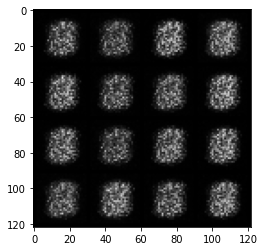

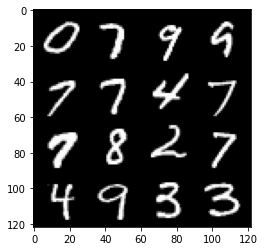

 94%|█████████▍| 441/469 [00:09<00:00, 33.20it/s]

1: step 900 / Gen loss: 3.1940570688247685 / disc_loss: 0.06567134478439887


 56%|█████▌    | 261/469 [00:05<00:04, 49.57it/s]

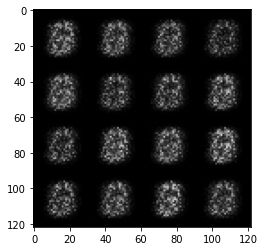

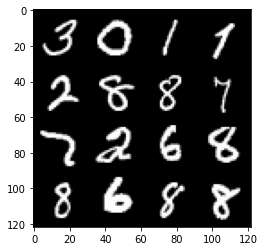

 58%|█████▊    | 272/469 [00:05<00:05, 33.21it/s]

2: step 1200 / Gen loss: 3.1942008940378814 / disc_loss: 0.04897109066446624


 19%|█▉        | 91/469 [00:01<00:07, 49.19it/s]

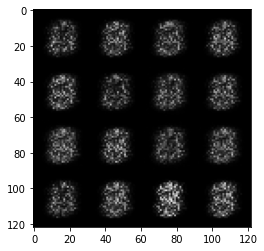

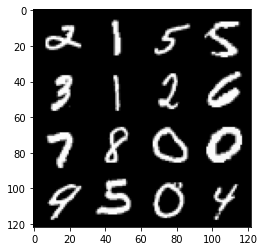

 22%|██▏       | 101/469 [00:02<00:11, 31.99it/s]

3: step 1500 / Gen loss: 3.4069991326332123 / disc_loss: 0.03770572917535902


 83%|████████▎ | 391/469 [00:08<00:01, 49.38it/s]

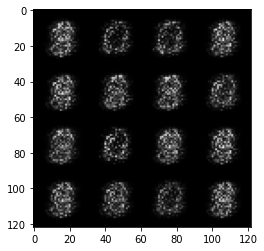

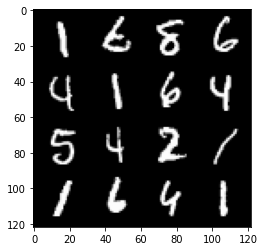

 86%|████████▌ | 402/469 [00:08<00:01, 34.20it/s]

3: step 1800 / Gen loss: 3.6882647291819257 / disc_loss: 0.034378420350452264


 47%|████▋     | 220/469 [00:04<00:04, 51.17it/s]

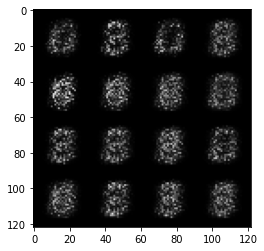

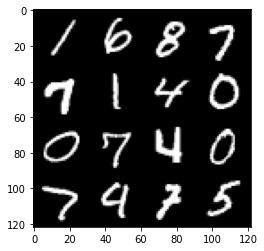

 49%|████▉     | 232/469 [00:04<00:06, 34.14it/s]

4: step 2100 / Gen loss: 3.9733967733383175 / disc_loss: 0.03315095010523994


 11%|█▏        | 53/469 [00:01<00:08, 50.25it/s]

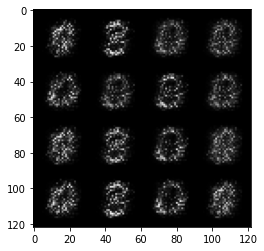

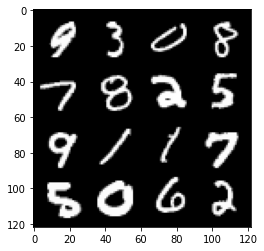

 14%|█▍        | 65/469 [00:01<00:11, 33.96it/s]

5: step 2400 / Gen loss: 4.446103085676827 / disc_loss: 0.02545600535348058


 75%|███████▍  | 350/469 [00:07<00:02, 50.34it/s]

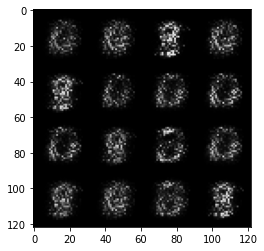

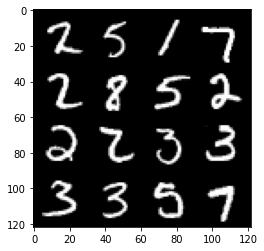

 77%|███████▋  | 360/469 [00:07<00:03, 28.79it/s]

5: step 2700 / Gen loss: 4.846548409461977 / disc_loss: 0.021908180204530562


 39%|███▊      | 181/469 [00:03<00:05, 52.06it/s]

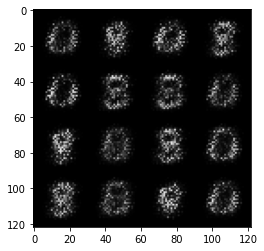

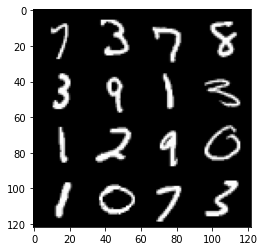

 41%|████      | 192/469 [00:04<00:08, 33.39it/s]

6: step 3000 / Gen loss: 5.0326813077926635 / disc_loss: 0.017529146022473775


  3%|▎         | 15/469 [00:00<00:10, 43.64it/s]

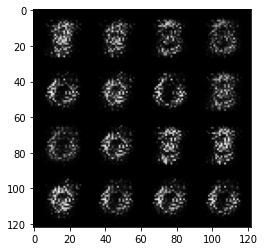

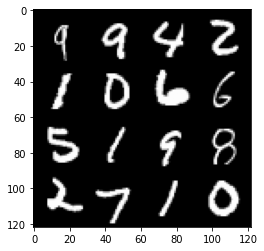

  6%|▌         | 26/469 [00:00<00:14, 30.00it/s]

7: step 3300 / Gen loss: 5.469964038530981 / disc_loss: 0.01446565470347803


 68%|██████▊   | 317/469 [00:06<00:03, 49.73it/s]

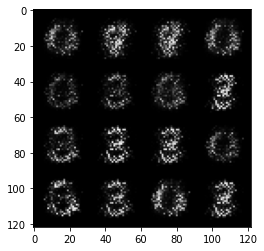

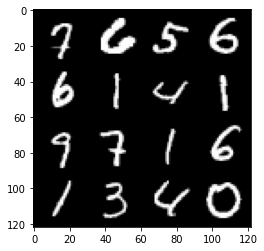

 70%|██████▉   | 327/469 [00:07<00:04, 33.35it/s]

7: step 3600 / Gen loss: 5.791318273544309 / disc_loss: 0.011319706225767735


 32%|███▏      | 148/469 [00:03<00:06, 49.38it/s]

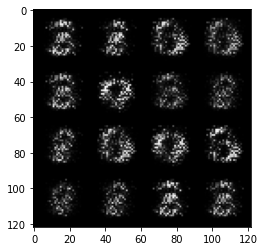

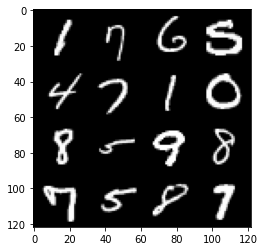

 34%|███▎      | 158/469 [00:03<00:09, 31.59it/s]

8: step 3900 / Gen loss: 6.041276241938277 / disc_loss: 0.010382720975515755


 96%|█████████▌| 448/469 [00:09<00:00, 48.55it/s]

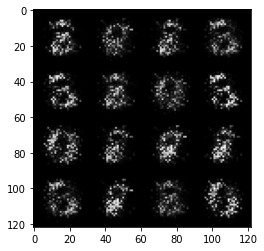

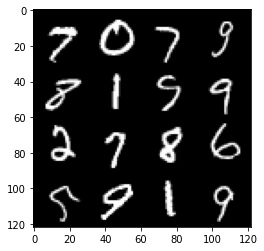

 98%|█████████▊| 458/469 [00:09<00:00, 31.40it/s]

8: step 4200 / Gen loss: 6.0584339157740255 / disc_loss: 0.010528811002926283


 59%|█████▉    | 277/469 [00:05<00:03, 49.05it/s]

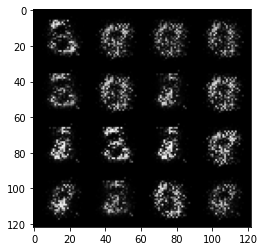

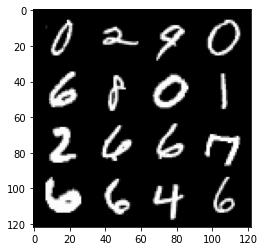

 61%|██████    | 287/469 [00:06<00:05, 31.73it/s]

9: step 4500 / Gen loss: 6.360859039624532 / disc_loss: 0.010157167986811448


 23%|██▎       | 109/469 [00:02<00:07, 49.03it/s]

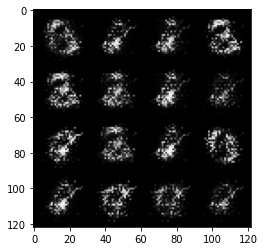

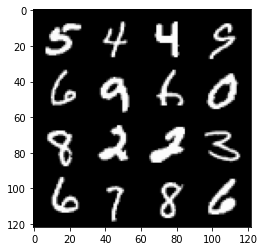

 26%|██▌       | 120/469 [00:02<00:11, 30.38it/s]

10: step 4800 / Gen loss: 6.4634578307469726 / disc_loss: 0.009203279657910261


 87%|████████▋ | 409/469 [00:08<00:01, 49.27it/s]

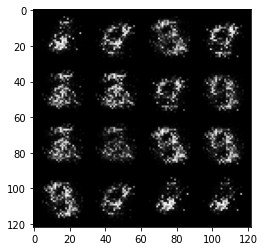

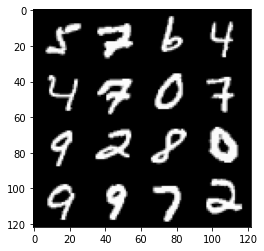

 89%|████████▉ | 419/469 [00:09<00:01, 31.40it/s]

10: step 5100 / Gen loss: 6.727294321060183 / disc_loss: 0.008978350909892473


 51%|█████     | 237/469 [00:04<00:04, 50.14it/s]

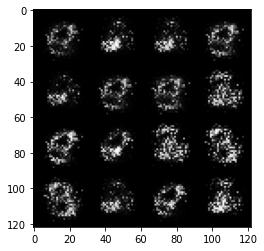

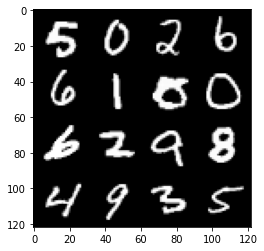

 53%|█████▎    | 249/469 [00:05<00:06, 33.67it/s]

11: step 5400 / Gen loss: 6.613540679613749 / disc_loss: 0.008019074565575763


 15%|█▌        | 72/469 [00:01<00:08, 47.75it/s]

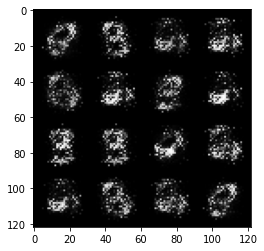

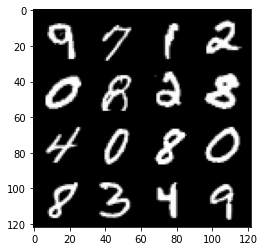

 18%|█▊        | 83/469 [00:01<00:12, 32.14it/s]

12: step 5700 / Gen loss: 6.458776075045265 / disc_loss: 0.00791104991920292


 79%|███████▉  | 372/469 [00:07<00:01, 51.07it/s]

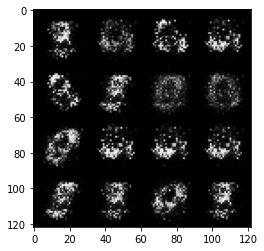

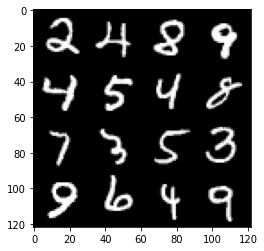

 81%|████████  | 378/469 [00:08<00:03, 30.04it/s]

12: step 6000 / Gen loss: 6.699482927322391 / disc_loss: 0.008534967254381621


 43%|████▎     | 201/469 [00:04<00:05, 47.30it/s]

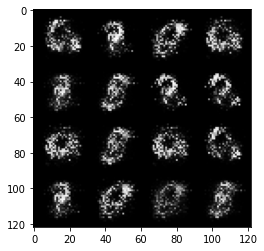

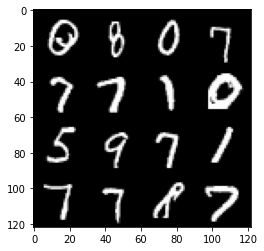

 45%|████▍     | 211/469 [00:04<00:08, 30.15it/s]

13: step 6300 / Gen loss: 7.165060955683389 / disc_loss: 0.008412778025570642


  6%|▋         | 30/469 [00:00<00:09, 48.01it/s]

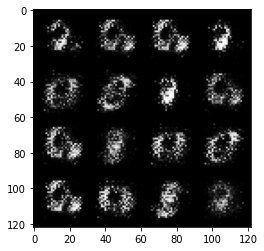

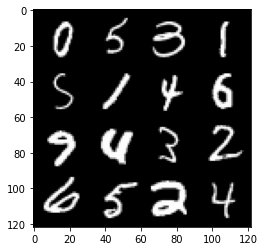

  9%|▊         | 40/469 [00:01<00:14, 30.08it/s]

14: step 6600 / Gen loss: 7.17105116049449 / disc_loss: 0.009506861981547751


 71%|███████   | 331/469 [00:07<00:02, 49.55it/s]

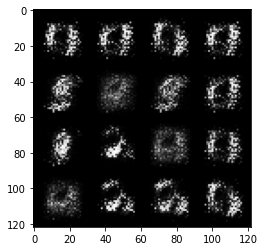

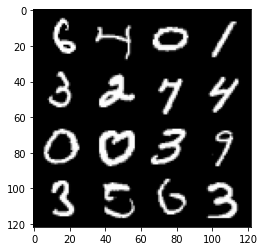

 73%|███████▎  | 341/469 [00:07<00:04, 31.44it/s]

14: step 6900 / Gen loss: 6.756289850870772 / disc_loss: 0.009062076929646237


 35%|███▌      | 165/469 [00:03<00:06, 47.30it/s]

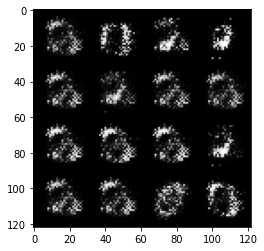

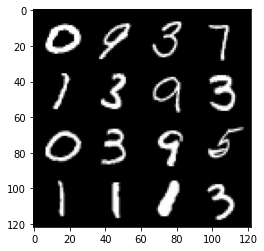

 38%|███▊      | 176/469 [00:03<00:09, 29.60it/s]

15: step 7200 / Gen loss: 7.15936134338379 / disc_loss: 0.007361707835613443


 98%|█████████▊| 461/469 [00:09<00:00, 45.33it/s]

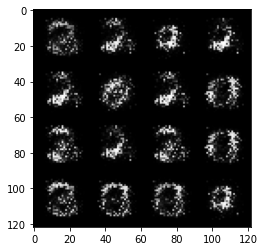

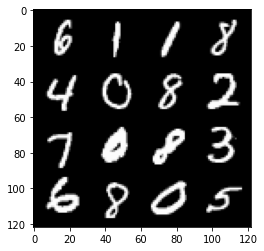

100%|██████████| 469/469 [00:10<00:00, 44.84it/s]


15: step 7500 / Gen loss: 7.378226631482448 / disc_loss: 0.006649253781264022


 63%|██████▎   | 294/469 [00:06<00:03, 47.22it/s]

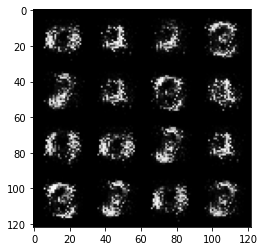

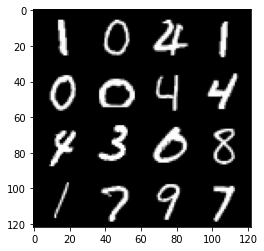

 65%|██████▍   | 304/469 [00:06<00:05, 30.83it/s]

16: step 7800 / Gen loss: 8.177634512583413 / disc_loss: 0.0063366086598641


 26%|██▋       | 124/469 [00:02<00:07, 47.56it/s]

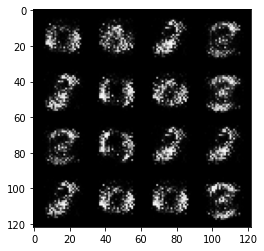

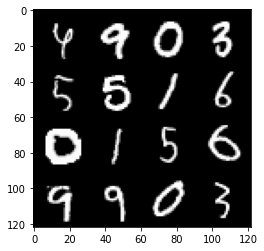

 29%|██▊       | 134/469 [00:03<00:10, 30.57it/s]

17: step 8100 / Gen loss: 7.634819518725078 / disc_loss: 0.00709389276530904


 91%|█████████ | 425/469 [00:09<00:00, 46.80it/s]

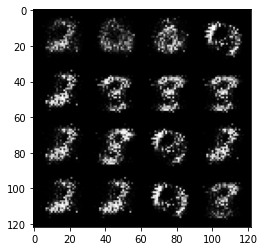

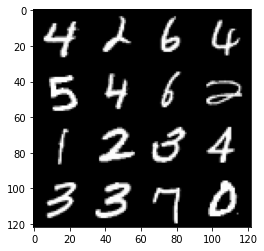

 93%|█████████▎| 435/469 [00:09<00:01, 30.76it/s]

17: step 8400 / Gen loss: 7.249952360788977 / disc_loss: 0.008928277377660077


 55%|█████▍    | 257/469 [00:05<00:04, 45.78it/s]

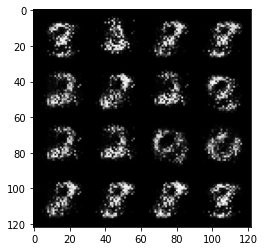

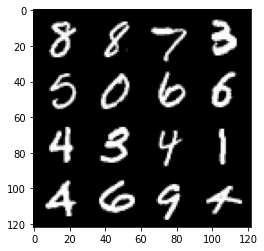

 57%|█████▋    | 267/469 [00:06<00:06, 29.85it/s]

18: step 8700 / Gen loss: 6.98748822053274 / disc_loss: 0.008905061940119289


 18%|█▊        | 86/469 [00:01<00:08, 47.45it/s]

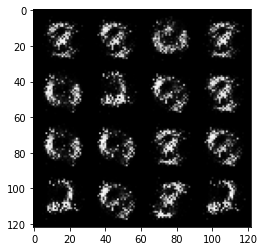

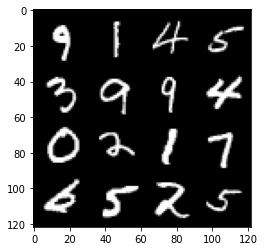

 20%|██        | 96/469 [00:02<00:11, 31.09it/s]

19: step 9000 / Gen loss: 7.5508824968337995 / disc_loss: 0.008136043882307913


 83%|████████▎ | 389/469 [00:08<00:01, 48.08it/s]

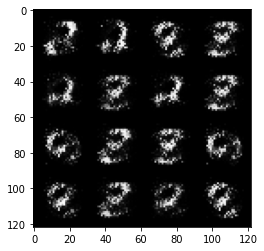

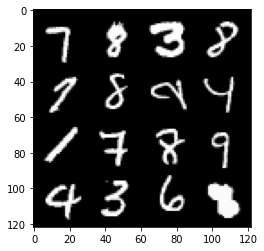

 85%|████████▌ | 399/469 [00:09<00:02, 28.36it/s]

19: step 9300 / Gen loss: 7.43815234343211 / disc_loss: 0.00890732939781932


 47%|████▋     | 219/469 [00:04<00:05, 47.61it/s]

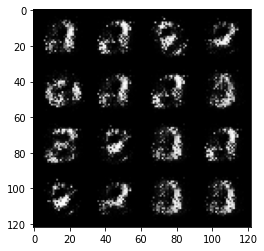

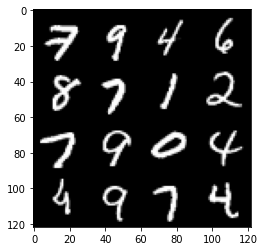

 49%|████▉     | 229/469 [00:05<00:08, 29.63it/s]

20: step 9600 / Gen loss: 6.904577647844956 / disc_loss: 0.008815163862503445


 10%|█         | 49/469 [00:01<00:09, 46.17it/s]

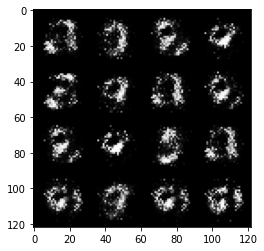

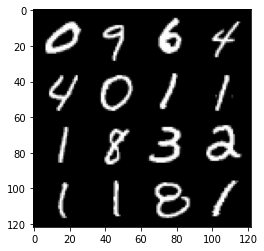

 12%|█▏        | 58/469 [00:01<00:14, 28.27it/s]

21: step 9900 / Gen loss: 7.129957938194272 / disc_loss: 0.009785961504094304


 74%|███████▍  | 347/469 [00:07<00:02, 46.43it/s]

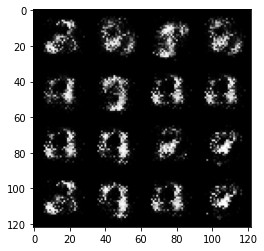

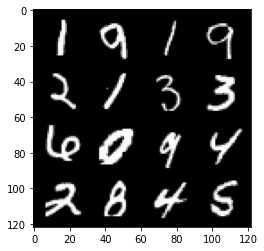

 76%|███████▌  | 356/469 [00:08<00:03, 28.82it/s]

21: step 10200 / Gen loss: 7.03274830182394 / disc_loss: 0.012447366642300034


 38%|███▊      | 179/469 [00:04<00:06, 44.69it/s]

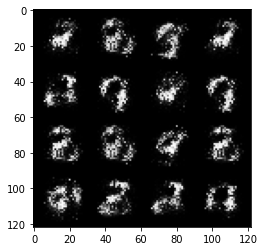

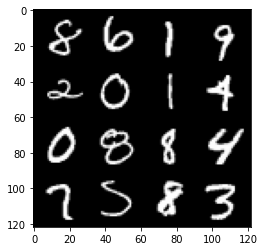

 40%|████      | 189/469 [00:04<00:09, 29.38it/s]

22: step 10500 / Gen loss: 6.5941936604181945 / disc_loss: 0.012359050170052793


  3%|▎         | 13/469 [00:00<00:10, 42.24it/s]

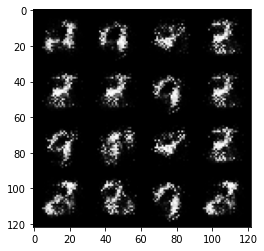

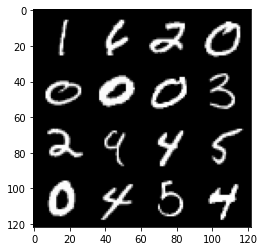

  5%|▍         | 23/469 [00:00<00:16, 26.38it/s]

23: step 10800 / Gen loss: 6.62548646132151 / disc_loss: 0.01103613363423695


 67%|██████▋   | 313/469 [00:07<00:03, 46.06it/s]

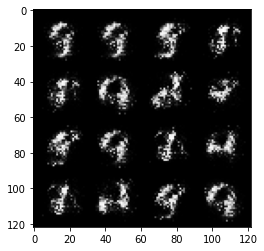

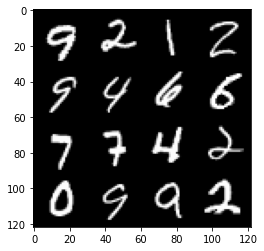

 69%|██████▉   | 323/469 [00:07<00:04, 29.40it/s]

23: step 11100 / Gen loss: 6.8805942916870135 / disc_loss: 0.010806605303660044


 31%|███       | 144/469 [00:03<00:06, 46.66it/s]

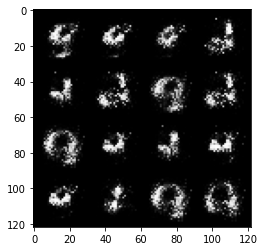

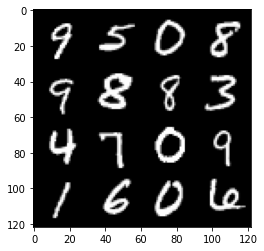

 33%|███▎      | 154/469 [00:03<00:10, 30.30it/s]

24: step 11400 / Gen loss: 7.075590113004051 / disc_loss: 0.012580074399011206


 94%|█████████▍| 443/469 [00:09<00:00, 46.22it/s]

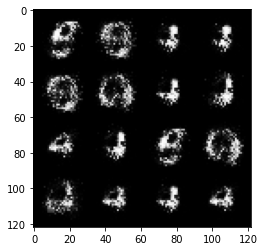

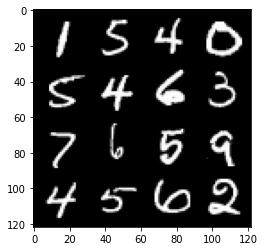

 96%|█████████▋| 452/469 [00:10<00:00, 25.59it/s]

24: step 11700 / Gen loss: 7.411160543759662 / disc_loss: 0.015552428399678324


 58%|█████▊    | 273/469 [00:06<00:04, 46.98it/s]

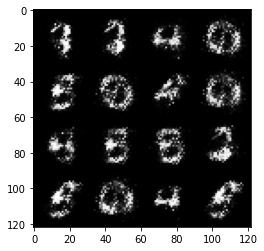

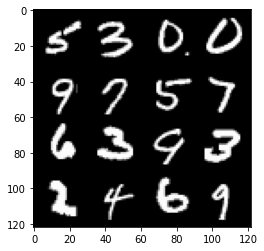

 60%|██████    | 282/469 [00:06<00:06, 28.68it/s]

25: step 12000 / Gen loss: 7.352655097643529 / disc_loss: 0.015466088631656022


 22%|██▏       | 104/469 [00:02<00:08, 45.59it/s]

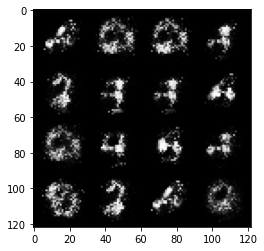

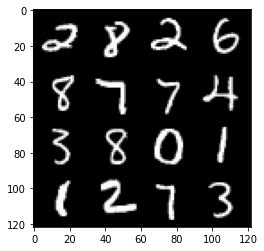

 24%|██▍       | 114/469 [00:02<00:11, 29.96it/s]

26: step 12300 / Gen loss: 7.107699046134951 / disc_loss: 0.015047819552322227


 86%|████████▌ | 403/469 [00:09<00:01, 46.48it/s]

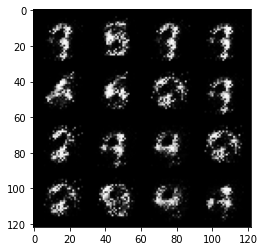

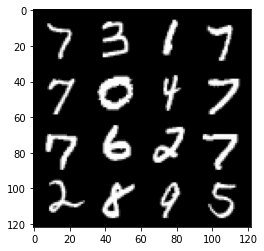

 88%|████████▊ | 412/469 [00:09<00:01, 28.50it/s]

26: step 12600 / Gen loss: 6.540460457801823 / disc_loss: 0.012786312493650875


 50%|████▉     | 233/469 [00:05<00:05, 46.96it/s]

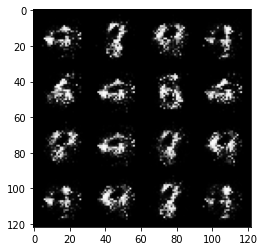

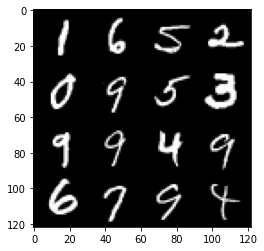

 52%|█████▏    | 242/469 [00:05<00:07, 28.80it/s]

27: step 12900 / Gen loss: 6.804805653889974 / disc_loss: 0.009315978786520043


 14%|█▍        | 68/469 [00:01<00:09, 44.14it/s]

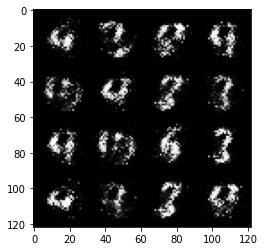

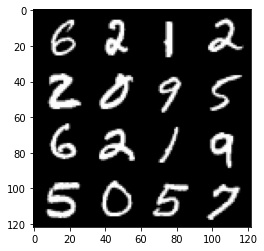

 16%|█▌        | 73/469 [00:02<00:16, 24.33it/s]

28: step 13200 / Gen loss: 7.21528661251068 / disc_loss: 0.009633616585827745


 78%|███████▊  | 366/469 [00:08<00:02, 43.50it/s]

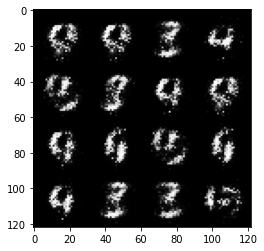

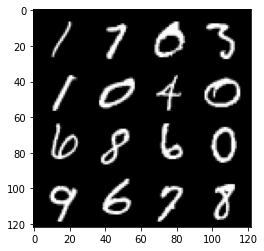

 80%|████████  | 376/469 [00:09<00:03, 28.42it/s]

28: step 13500 / Gen loss: 7.179415623346962 / disc_loss: 0.013878406232688588


 42%|████▏     | 196/469 [00:04<00:06, 43.84it/s]

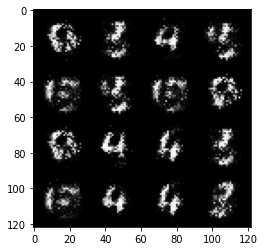

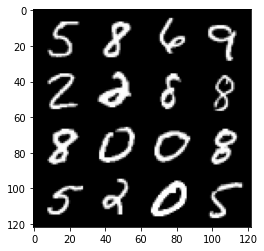

 44%|████▎     | 205/469 [00:05<00:10, 25.13it/s]

29: step 13800 / Gen loss: 6.933701079686478 / disc_loss: 0.01676341499745225


  6%|▋         | 30/469 [00:00<00:09, 45.17it/s]

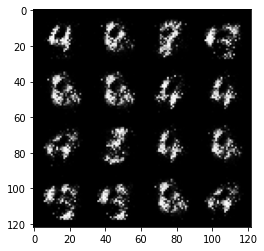

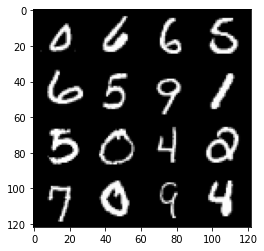

  9%|▊         | 40/469 [00:01<00:15, 28.43it/s]

30: step 14100 / Gen loss: 6.146197808583579 / disc_loss: 0.014862714679911737


 70%|███████   | 329/469 [00:07<00:03, 45.07it/s]

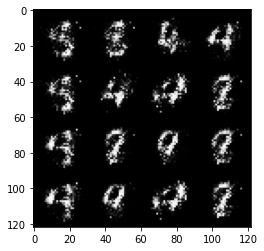

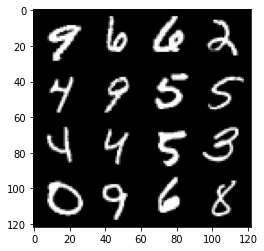

 72%|███████▏  | 339/469 [00:08<00:04, 28.64it/s]

30: step 14400 / Gen loss: 6.428642493883772 / disc_loss: 0.01262369217040639


 34%|███▎      | 158/469 [00:03<00:06, 45.02it/s]

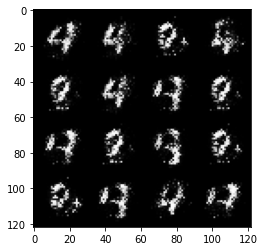

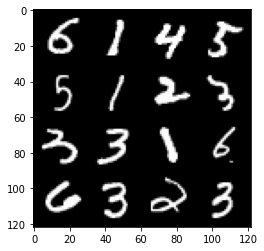

 36%|███▌      | 167/469 [00:04<00:10, 27.53it/s]

31: step 14700 / Gen loss: 6.340143446922301 / disc_loss: 0.009854821601572143


 98%|█████████▊| 461/469 [00:10<00:00, 45.41it/s]

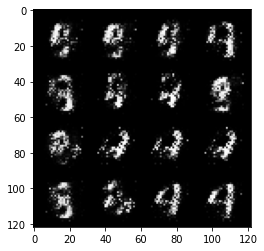

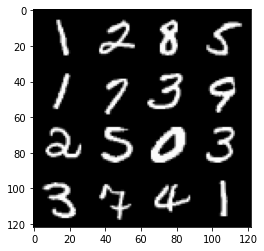

100%|██████████| 469/469 [00:11<00:00, 41.73it/s]


31: step 15000 / Gen loss: 6.740723592440285 / disc_loss: 0.01058131355365427


 62%|██████▏   | 289/469 [00:06<00:04, 44.37it/s]

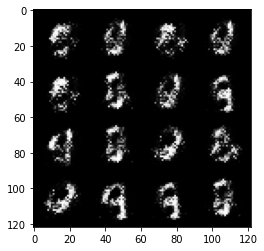

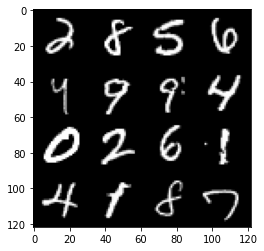

 64%|██████▎   | 298/469 [00:07<00:06, 27.78it/s]

32: step 15300 / Gen loss: 6.794642955462137 / disc_loss: 0.014869757176687318


 26%|██▌       | 123/469 [00:02<00:07, 44.64it/s]

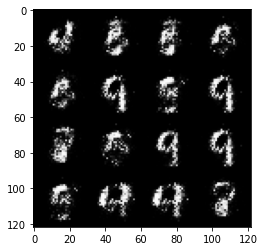

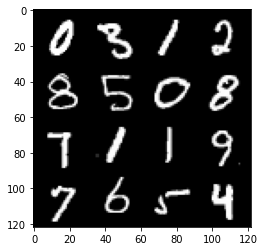

 27%|██▋       | 128/469 [00:03<00:13, 24.93it/s]

33: step 15600 / Gen loss: 6.1717391475041765 / disc_loss: 0.019874930388759832


 90%|████████▉ | 422/469 [00:10<00:01, 43.41it/s]

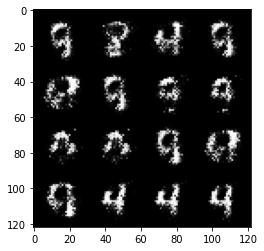

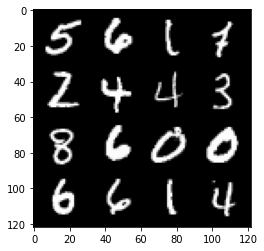

 92%|█████████▏| 431/469 [00:10<00:01, 27.16it/s]

33: step 15900 / Gen loss: 6.2930715799331605 / disc_loss: 0.020669509557386233


 54%|█████▍    | 253/469 [00:05<00:05, 42.18it/s]

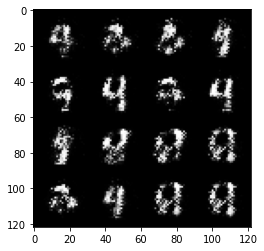

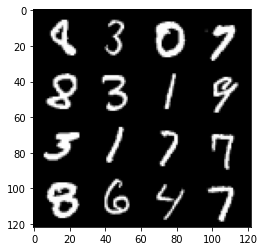

 56%|█████▌    | 263/469 [00:06<00:08, 25.30it/s]

34: step 16200 / Gen loss: 6.126303264300027 / disc_loss: 0.019497219236412386


 18%|█▊        | 84/469 [00:01<00:08, 43.32it/s]

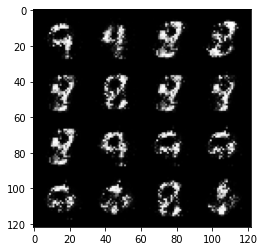

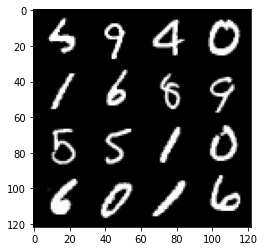

 20%|█▉        | 93/469 [00:02<00:13, 27.25it/s]

35: step 16500 / Gen loss: 6.357715233167017 / disc_loss: 0.01669521605595944


 81%|████████  | 381/469 [00:09<00:02, 42.69it/s]

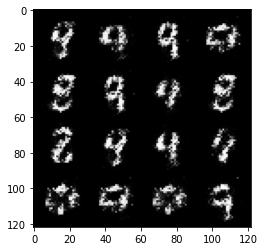

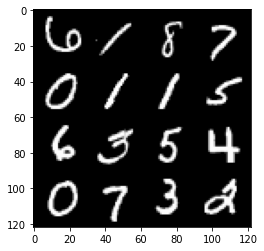

 83%|████████▎ | 390/469 [00:09<00:02, 27.54it/s]

35: step 16800 / Gen loss: 6.388635606765746 / disc_loss: 0.017296798424019152


 45%|████▌     | 213/469 [00:04<00:05, 45.42it/s]

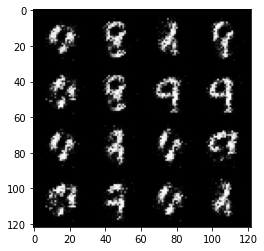

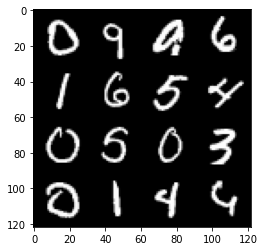

 47%|████▋     | 222/469 [00:05<00:08, 27.87it/s]

36: step 17100 / Gen loss: 6.180462600390113 / disc_loss: 0.01861120110765721


 10%|▉         | 45/469 [00:01<00:09, 42.75it/s]

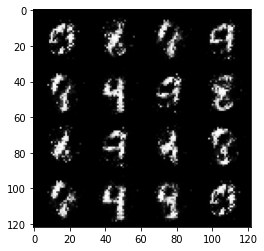

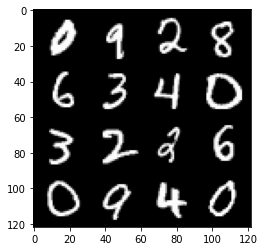

 12%|█▏        | 54/469 [00:01<00:15, 26.59it/s]

37: step 17400 / Gen loss: 6.249921075503031 / disc_loss: 0.018870340892268973


 74%|███████▍  | 347/469 [00:08<00:02, 42.32it/s]

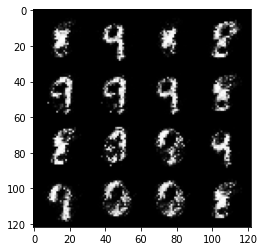

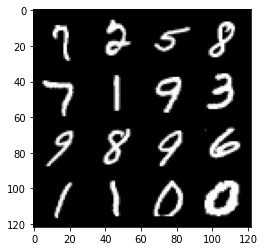

 75%|███████▌  | 352/469 [00:08<00:04, 24.62it/s]

37: step 17700 / Gen loss: 6.107891481717427 / disc_loss: 0.021935531800457594


 38%|███▊      | 178/469 [00:04<00:06, 43.43it/s]

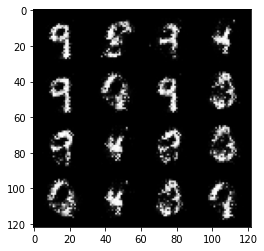

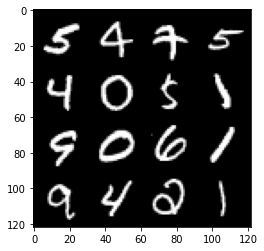

 39%|███▉      | 183/469 [00:04<00:12, 23.75it/s]

38: step 18000 / Gen loss: 6.218280765215555 / disc_loss: 0.019299688283354034


  2%|▏         | 8/469 [00:00<00:12, 36.84it/s]

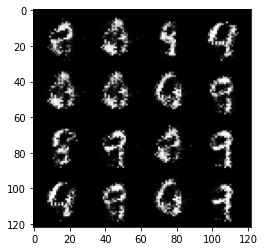

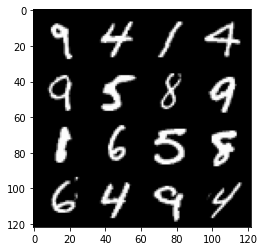

  3%|▎         | 16/469 [00:00<00:24, 18.55it/s]

39: step 18300 / Gen loss: 6.256033538182573 / disc_loss: 0.020547405611723666


 66%|██████▌   | 308/469 [00:07<00:03, 41.69it/s]

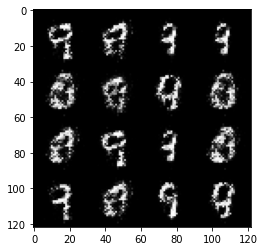

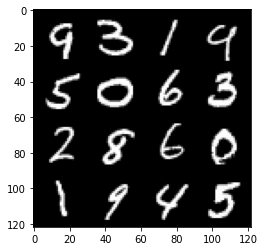

 68%|██████▊   | 317/469 [00:08<00:05, 26.90it/s]

39: step 18600 / Gen loss: 6.018788234392798 / disc_loss: 0.02416603319928979


 29%|██▉       | 137/469 [00:03<00:07, 43.86it/s]

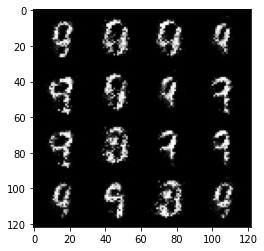

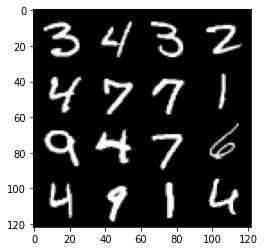

 31%|███       | 146/469 [00:03<00:12, 26.80it/s]

40: step 18900 / Gen loss: 6.340197415351869 / disc_loss: 0.024583606389351195


 93%|█████████▎| 437/469 [00:10<00:00, 41.92it/s]

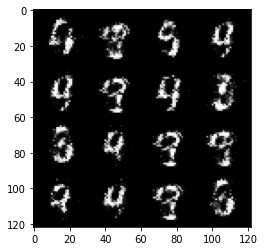

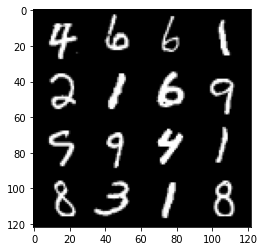

 95%|█████████▌| 446/469 [00:11<00:00, 27.43it/s]

40: step 19200 / Gen loss: 6.091166458129878 / disc_loss: 0.02280917909151564


 58%|█████▊    | 270/469 [00:06<00:04, 41.46it/s]

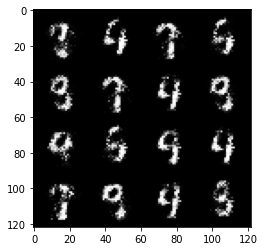

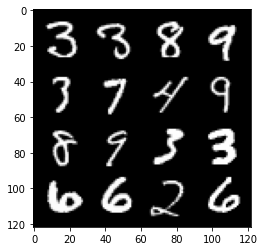

 60%|█████▉    | 280/469 [00:06<00:06, 27.64it/s]

41: step 19500 / Gen loss: 5.808499790827434 / disc_loss: 0.02390536994130039


 21%|██        | 98/469 [00:02<00:08, 44.01it/s]

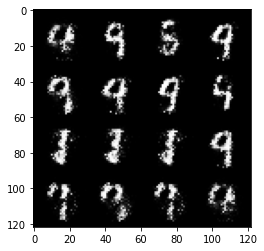

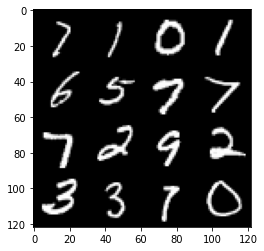

 23%|██▎       | 107/469 [00:02<00:13, 27.73it/s]

42: step 19800 / Gen loss: 5.549420896371211 / disc_loss: 0.03006661085567125


 86%|████████▌ | 401/469 [00:10<00:01, 35.07it/s]

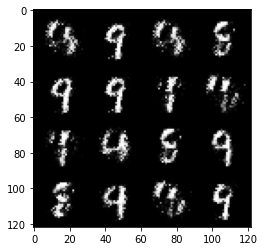

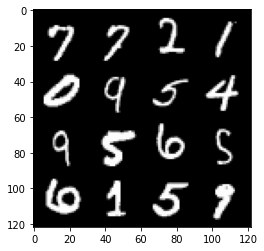

 87%|████████▋ | 409/469 [00:11<00:02, 21.16it/s]

42: step 20100 / Gen loss: 6.198955259323121 / disc_loss: 0.031017213387725274


 50%|████▉     | 233/469 [00:05<00:05, 43.43it/s]

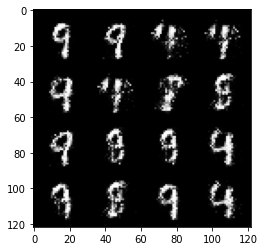

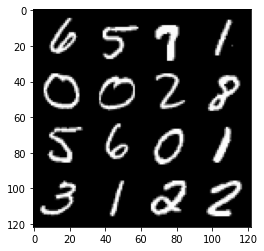

 51%|█████     | 238/469 [00:06<00:09, 23.91it/s]

43: step 20400 / Gen loss: 5.657655434608459 / disc_loss: 0.027792506848151485


 13%|█▎        | 63/469 [00:01<00:09, 41.31it/s]

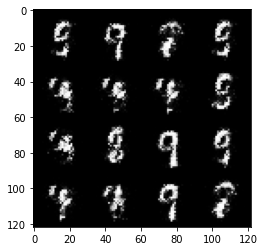

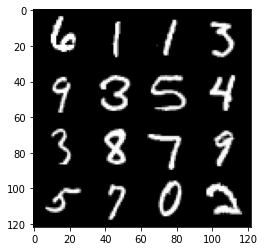

 15%|█▌        | 72/469 [00:02<00:15, 24.84it/s]

44: step 20700 / Gen loss: 5.784276428222657 / disc_loss: 0.026671600344901295


 77%|███████▋  | 361/469 [00:09<00:02, 41.51it/s]

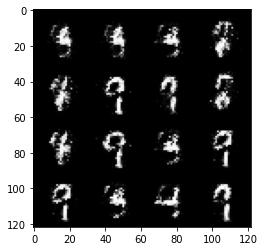

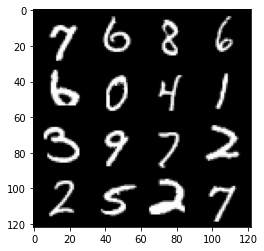

 79%|███████▉  | 370/469 [00:09<00:03, 27.05it/s]

44: step 21000 / Gen loss: 5.866005873680112 / disc_loss: 0.033928068441649264


 41%|████      | 192/469 [00:04<00:06, 44.23it/s]

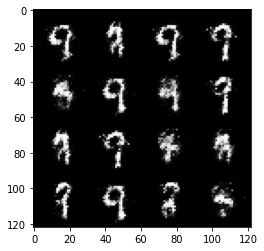

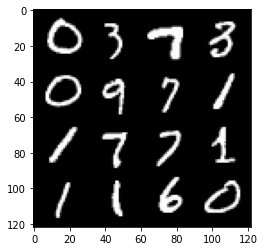

 43%|████▎     | 201/469 [00:05<00:09, 27.51it/s]

45: step 21300 / Gen loss: 6.1402939367294325 / disc_loss: 0.03539994531931975


  6%|▌         | 26/469 [00:00<00:11, 39.39it/s]

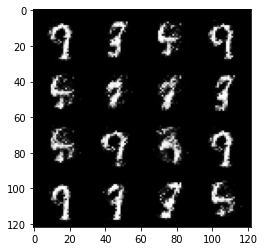

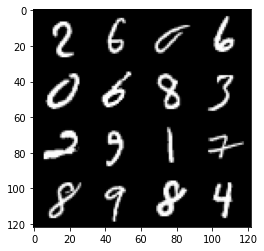

  6%|▋         | 30/469 [00:01<00:22, 19.74it/s]

46: step 21600 / Gen loss: 5.4718149137496965 / disc_loss: 0.03867504130738478


 69%|██████▊   | 322/469 [00:08<00:03, 41.48it/s]

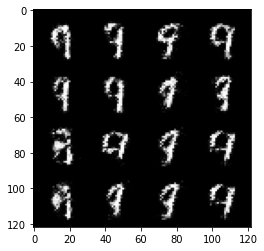

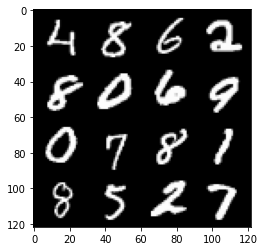

 71%|███████   | 331/469 [00:08<00:05, 27.52it/s]

46: step 21900 / Gen loss: 5.507947080930072 / disc_loss: 0.03701550904661416


 33%|███▎      | 156/469 [00:03<00:07, 42.51it/s]

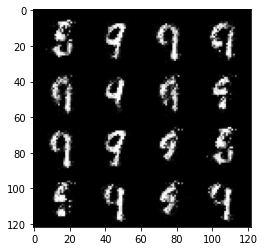

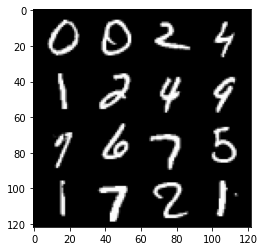

 35%|███▌      | 166/469 [00:04<00:10, 28.29it/s]

47: step 22200 / Gen loss: 5.560593980153403 / disc_loss: 0.04034368437559654


 97%|█████████▋| 453/469 [00:11<00:00, 42.61it/s]

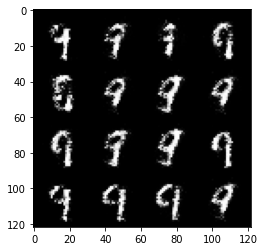

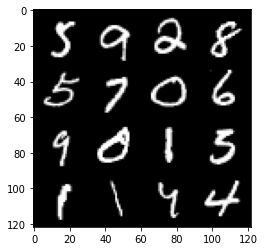

 99%|█████████▊| 462/469 [00:11<00:00, 27.62it/s]

47: step 22500 / Gen loss: 5.765872031847636 / disc_loss: 0.03948188783600928


 61%|██████    | 284/469 [00:06<00:04, 42.78it/s]

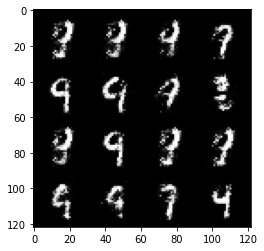

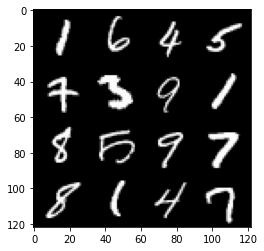

 62%|██████▏   | 293/469 [00:07<00:07, 24.66it/s]

48: step 22800 / Gen loss: 5.350290071169538 / disc_loss: 0.04407952156538766


 25%|██▌       | 119/469 [00:02<00:08, 41.46it/s]

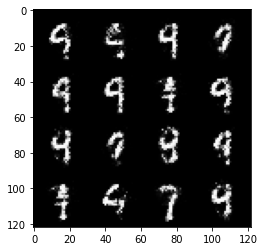

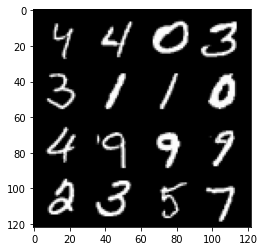

 26%|██▋       | 124/469 [00:03<00:14, 23.09it/s]

49: step 23100 / Gen loss: 4.944667807420097 / disc_loss: 0.05484203254804019


 89%|████████▊ | 416/469 [00:10<00:01, 41.50it/s]

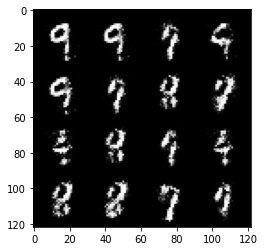

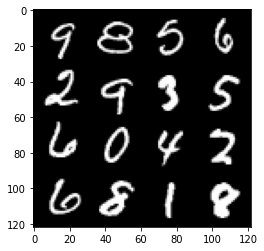

 91%|█████████ | 425/469 [00:11<00:01, 25.85it/s]

49: step 23400 / Gen loss: 5.05487235705058 / disc_loss: 0.05045297246426343


 53%|█████▎    | 247/469 [00:05<00:05, 41.56it/s]

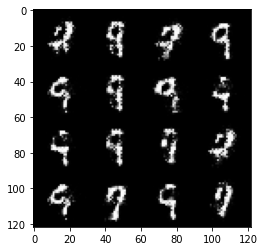

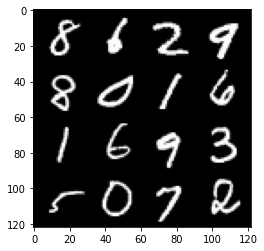

 55%|█████▍    | 256/469 [00:06<00:07, 26.82it/s]

50: step 23700 / Gen loss: 5.248514275550842 / disc_loss: 0.04563987018695724


 17%|█▋        | 78/469 [00:01<00:09, 41.54it/s]

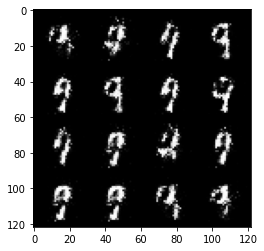

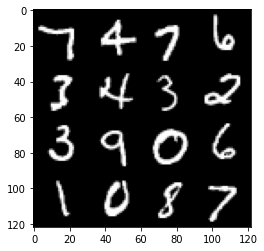

 19%|█▊        | 87/469 [00:02<00:14, 26.34it/s]

51: step 24000 / Gen loss: 5.644151509602862 / disc_loss: 0.045525800646282664


 80%|████████  | 377/469 [00:09<00:02, 41.11it/s]

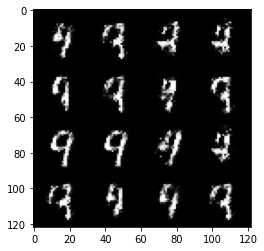

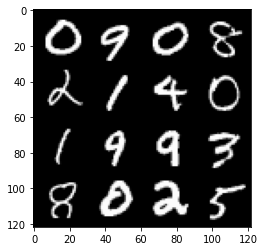

 83%|████████▎ | 387/469 [00:10<00:02, 28.16it/s]

51: step 24300 / Gen loss: 5.747140234311427 / disc_loss: 0.046390349653859936


 45%|████▍     | 209/469 [00:05<00:06, 39.57it/s]

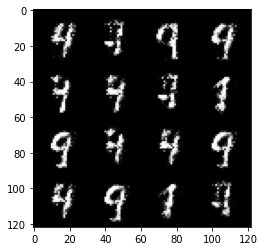

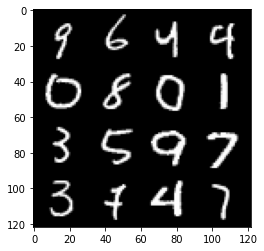

 46%|████▋     | 217/469 [00:05<00:09, 26.57it/s]

52: step 24600 / Gen loss: 5.53989215532939 / disc_loss: 0.05945347183073564


  9%|▊         | 41/469 [00:01<00:10, 39.14it/s]

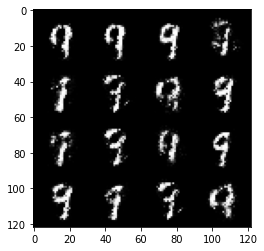

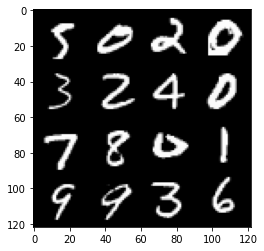

 10%|█         | 49/469 [00:01<00:18, 23.06it/s]

53: step 24900 / Gen loss: 5.648456546465552 / disc_loss: 0.05709156430947286


 73%|███████▎  | 341/469 [00:08<00:03, 41.71it/s]

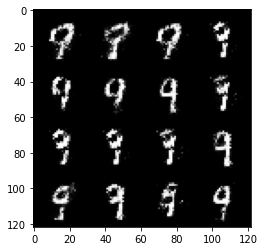

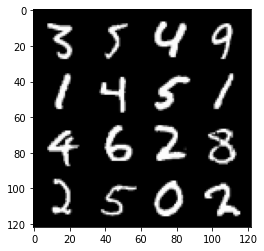

 75%|███████▍  | 350/469 [00:09<00:04, 24.50it/s]

53: step 25200 / Gen loss: 5.3844044009844545 / disc_loss: 0.056793208966652554


 36%|███▋      | 171/469 [00:04<00:07, 42.07it/s]

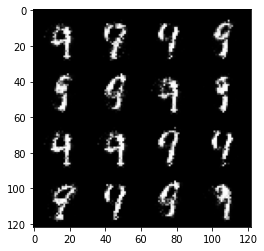

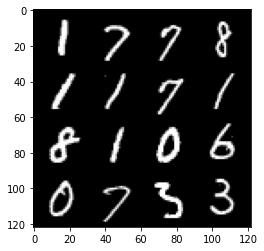

 38%|███▊      | 180/469 [00:04<00:10, 27.14it/s]

54: step 25500 / Gen loss: 5.172560594876602 / disc_loss: 0.0527013775644203


  1%|          | 4/469 [00:00<00:12, 38.24it/s]

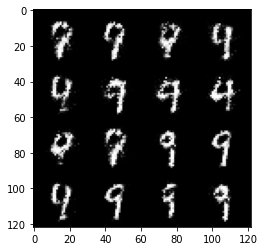

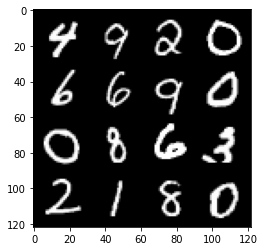

  3%|▎         | 12/469 [00:00<00:25, 17.83it/s]

55: step 25800 / Gen loss: 4.854422694842023 / disc_loss: 0.05798766422706344


 65%|██████▌   | 305/469 [00:08<00:03, 41.01it/s]

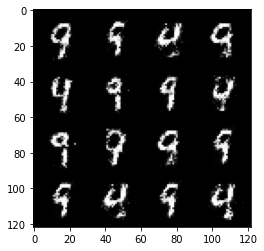

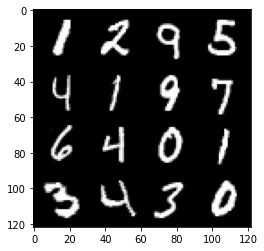

 66%|██████▌   | 310/469 [00:08<00:06, 22.93it/s]

55: step 26100 / Gen loss: 5.114592345555622 / disc_loss: 0.04986344088334587


 29%|██▉       | 135/469 [00:03<00:08, 38.13it/s]

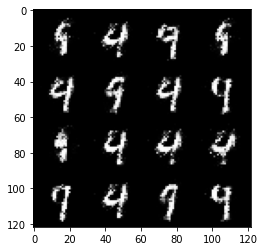

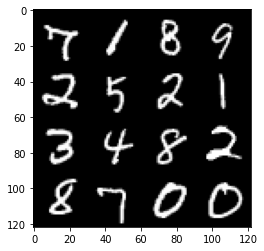

 30%|███       | 143/469 [00:04<00:13, 23.67it/s]

56: step 26400 / Gen loss: 5.009609271685284 / disc_loss: 0.052519522445897235


 93%|█████████▎| 435/469 [00:11<00:00, 39.77it/s]

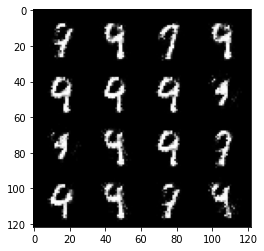

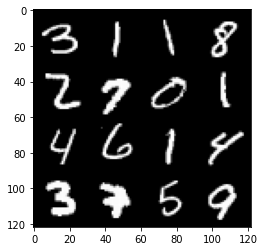

 95%|█████████▍| 444/469 [00:11<00:00, 25.62it/s]

56: step 26700 / Gen loss: 5.036426885922753 / disc_loss: 0.057605356120814896


 57%|█████▋    | 267/469 [00:06<00:05, 37.33it/s]

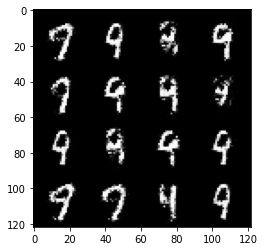

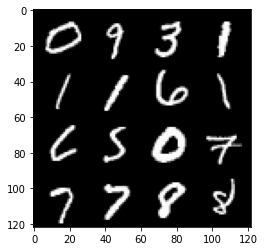

 59%|█████▊    | 275/469 [00:07<00:08, 23.93it/s]

57: step 27000 / Gen loss: 4.759725032647452 / disc_loss: 0.06438876172062007


 21%|██        | 97/469 [00:02<00:09, 38.96it/s]

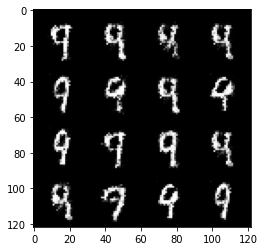

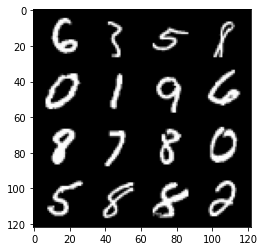

 22%|██▏       | 105/469 [00:03<00:16, 21.57it/s]

58: step 27300 / Gen loss: 4.97615077336629 / disc_loss: 0.05067377219287064


 85%|████████▍ | 398/469 [00:10<00:01, 41.57it/s]

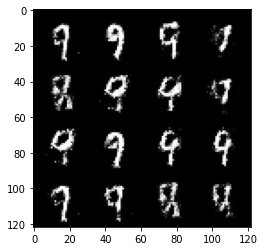

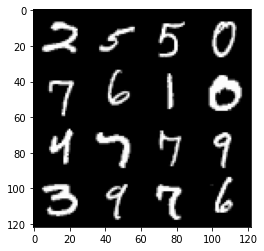

 86%|████████▌ | 403/469 [00:10<00:02, 23.54it/s]

58: step 27600 / Gen loss: 5.00448775132497 / disc_loss: 0.056004315496732765


 49%|████▉     | 229/469 [00:05<00:06, 38.23it/s]

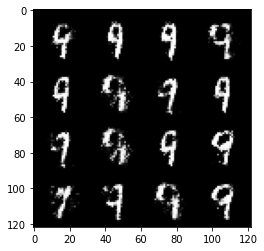

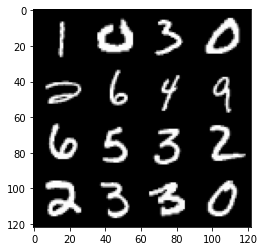

 51%|█████     | 237/469 [00:06<00:10, 23.01it/s]

59: step 27900 / Gen loss: 5.057392186323803 / disc_loss: 0.06247149791878953


 13%|█▎        | 59/469 [00:01<00:10, 39.65it/s]

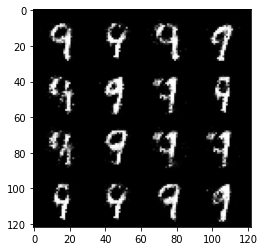

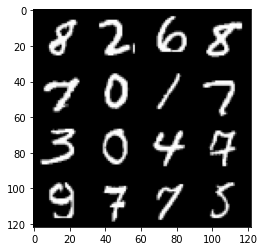

 14%|█▍        | 67/469 [00:02<00:16, 23.66it/s]

60: step 28200 / Gen loss: 5.073747633298239 / disc_loss: 0.05416156908807656


 77%|███████▋  | 359/469 [00:09<00:02, 39.54it/s]

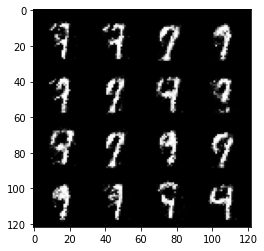

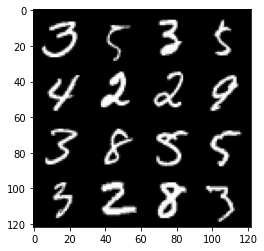

 78%|███████▊  | 367/469 [00:10<00:04, 24.34it/s]

60: step 28500 / Gen loss: 4.790203158060712 / disc_loss: 0.06033138755088049


 41%|████      | 190/469 [00:04<00:07, 38.09it/s]

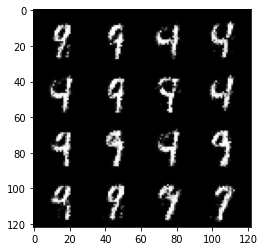

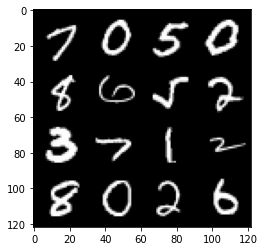

 42%|████▏     | 198/469 [00:05<00:12, 21.83it/s]

61: step 28800 / Gen loss: 4.447624518076578 / disc_loss: 0.08666484696790577


  5%|▍         | 22/469 [00:00<00:11, 39.42it/s]

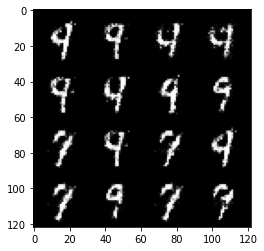

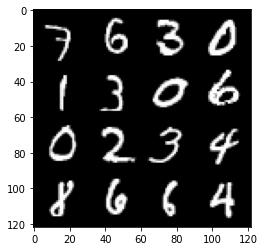

  6%|▋         | 30/469 [00:01<00:20, 20.97it/s]

62: step 29100 / Gen loss: 4.478918999036153 / disc_loss: 0.08457041155546914


 68%|██████▊   | 319/469 [00:08<00:03, 38.02it/s]

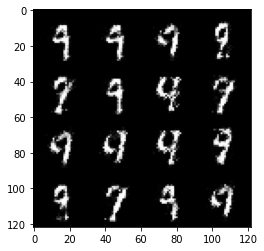

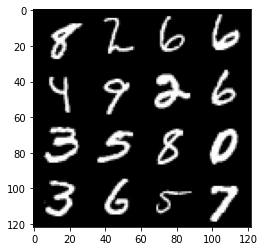

 70%|██████▉   | 327/469 [00:09<00:06, 22.38it/s]

62: step 29400 / Gen loss: 4.541448284784955 / disc_loss: 0.06989914586146677


 32%|███▏      | 150/469 [00:03<00:08, 38.18it/s]

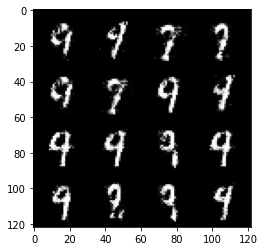

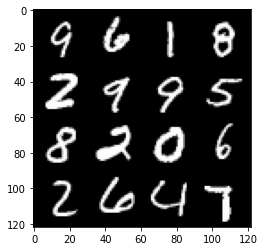

 34%|███▎      | 158/469 [00:04<00:15, 20.55it/s]

63: step 29700 / Gen loss: 4.694491463502246 / disc_loss: 0.07441035792852445


 97%|█████████▋| 453/469 [00:12<00:00, 37.80it/s]

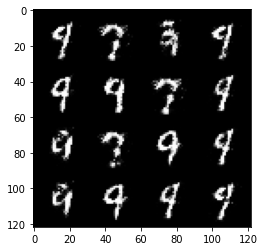

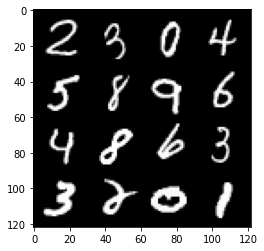

 98%|█████████▊| 461/469 [00:12<00:00, 22.28it/s]

63: step 30000 / Gen loss: 4.477460862000784 / disc_loss: 0.08539039596294368


 61%|██████    | 284/469 [00:07<00:04, 37.96it/s]

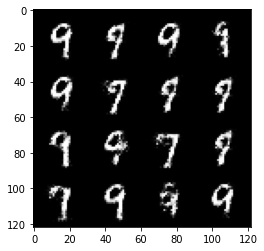

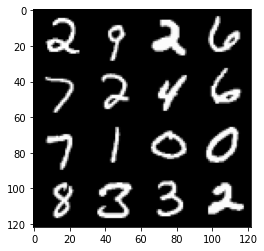

 62%|██████▏   | 293/469 [00:07<00:07, 23.63it/s]

64: step 30300 / Gen loss: 4.482467208703361 / disc_loss: 0.09698473449175561


 24%|██▍       | 112/469 [00:02<00:08, 39.69it/s]

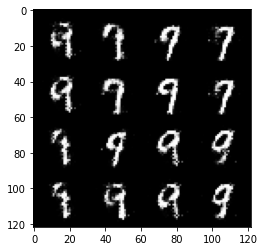

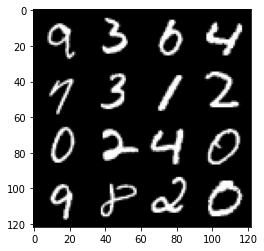

 26%|██▌       | 120/469 [00:03<00:14, 23.80it/s]

65: step 30600 / Gen loss: 4.331207458972934 / disc_loss: 0.07672849860042336


 88%|████████▊ | 413/469 [00:10<00:01, 39.51it/s]

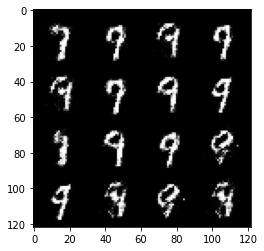

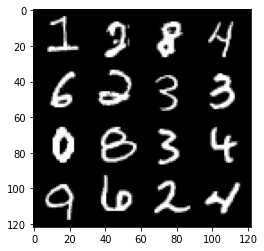

 90%|████████▉ | 422/469 [00:11<00:01, 24.18it/s]

65: step 30900 / Gen loss: 4.3926793058713285 / disc_loss: 0.06558474981536469


 52%|█████▏    | 246/469 [00:06<00:05, 37.49it/s]

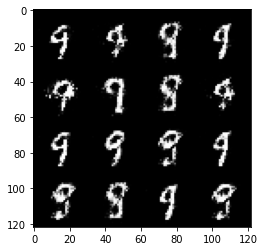

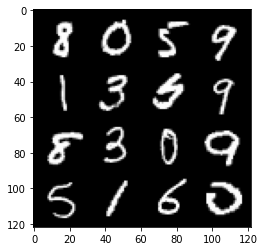

 54%|█████▍    | 254/469 [00:06<00:09, 22.64it/s]

66: step 31200 / Gen loss: 4.338995887438454 / disc_loss: 0.07023044777723653


 16%|█▌        | 75/469 [00:01<00:09, 40.91it/s]

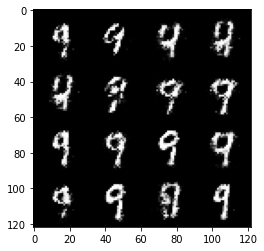

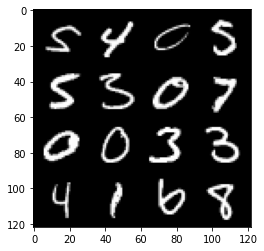

 18%|█▊        | 85/469 [00:02<00:15, 25.17it/s]

67: step 31500 / Gen loss: 4.739513267676034 / disc_loss: 0.06663686537494264


 80%|███████▉  | 374/469 [00:09<00:02, 38.91it/s]

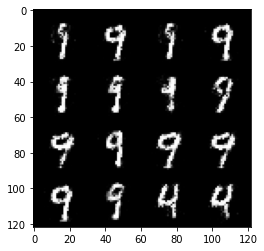

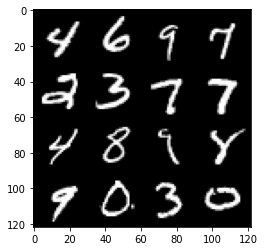

 81%|████████▏ | 382/469 [00:10<00:03, 22.43it/s]

67: step 31800 / Gen loss: 4.33116319735845 / disc_loss: 0.0847100839018822


 44%|████▎     | 205/469 [00:05<00:06, 38.61it/s]

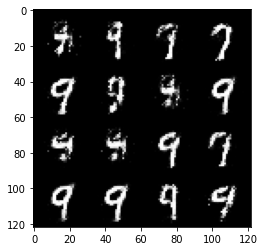

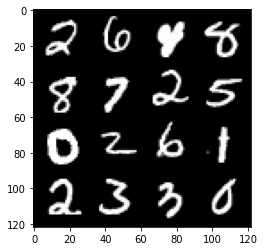

 45%|████▌     | 213/469 [00:05<00:12, 20.05it/s]

68: step 32100 / Gen loss: 4.275999884605414 / disc_loss: 0.10407593325401347


  8%|▊         | 36/469 [00:00<00:11, 38.16it/s]

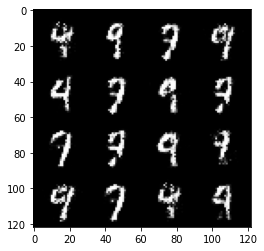

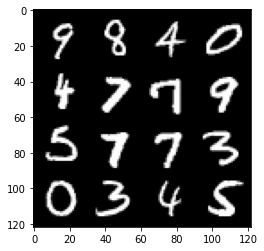

 10%|▉         | 45/469 [00:01<00:18, 23.03it/s]

69: step 32400 / Gen loss: 4.161682334740956 / disc_loss: 0.09810709868247305


 72%|███████▏  | 337/469 [00:09<00:03, 35.49it/s]

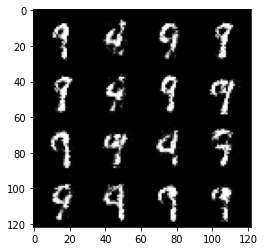

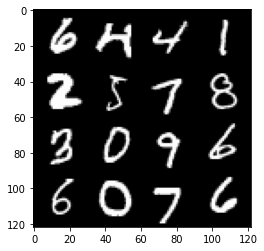

 74%|███████▎  | 345/469 [00:09<00:05, 21.99it/s]

69: step 32700 / Gen loss: 4.11969284613927 / disc_loss: 0.09797658014421666


 36%|███▌      | 167/469 [00:04<00:07, 39.01it/s]

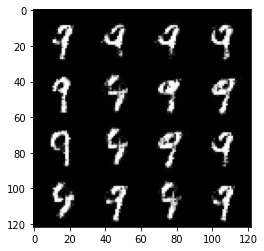

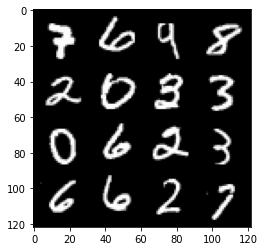

 38%|███▊      | 176/469 [00:04<00:12, 23.39it/s]

70: step 33000 / Gen loss: 3.962310971419019 / disc_loss: 0.09488727149864036


  0%|          | 0/469 [00:00<?, ?it/s]

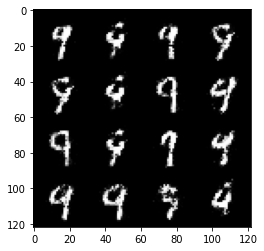

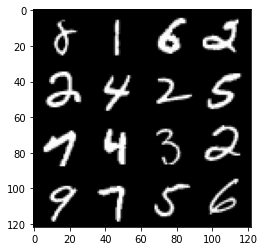

  1%|▏         | 6/469 [00:00<00:33, 13.84it/s]

71: step 33300 / Gen loss: 3.886139907836912 / disc_loss: 0.09418328613042837


 64%|██████▍   | 301/469 [00:08<00:04, 38.33it/s]

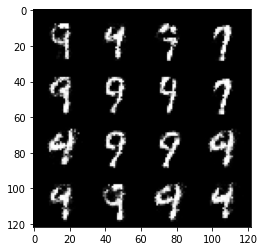

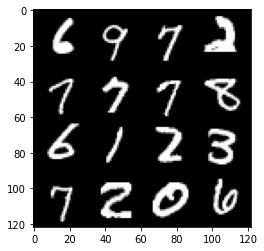

 66%|██████▌   | 309/469 [00:08<00:07, 22.23it/s]

71: step 33600 / Gen loss: 4.057349858283999 / disc_loss: 0.08076252755398548


 27%|██▋       | 128/469 [00:03<00:08, 39.28it/s]

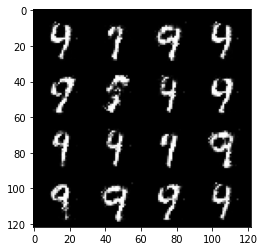

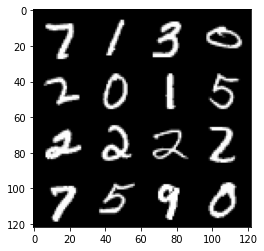

 29%|██▉       | 137/469 [00:03<00:13, 23.74it/s]

72: step 33900 / Gen loss: 4.303029464880625 / disc_loss: 0.08099946344271301


 91%|█████████▏| 429/469 [00:11<00:01, 37.02it/s]

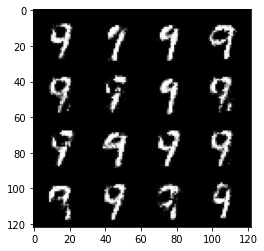

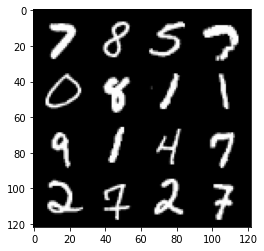

 93%|█████████▎| 437/469 [00:12<00:01, 22.12it/s]

72: step 34200 / Gen loss: 4.056116617520651 / disc_loss: 0.08084737146273252


 56%|█████▌    | 261/469 [00:06<00:05, 39.70it/s]

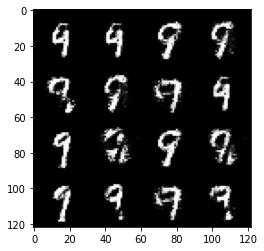

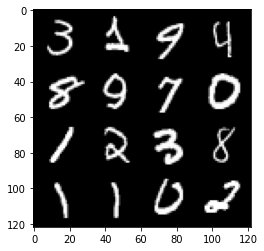

 57%|█████▋    | 269/469 [00:07<00:09, 21.21it/s]

73: step 34500 / Gen loss: 4.0251335620880155 / disc_loss: 0.106350010757645


 20%|█▉        | 93/469 [00:02<00:09, 39.81it/s]

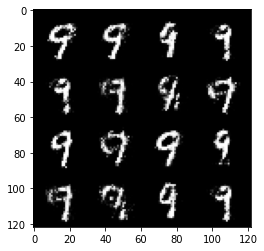

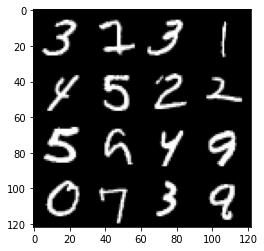

 22%|██▏       | 102/469 [00:02<00:15, 23.51it/s]

74: step 34800 / Gen loss: 4.076674427986147 / disc_loss: 0.08946485274160895


 84%|████████▍ | 394/469 [00:10<00:01, 38.24it/s]

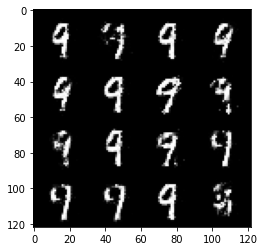

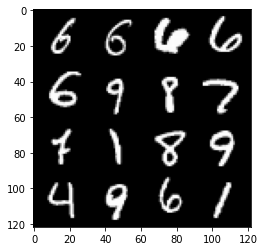

 86%|████████▌ | 402/469 [00:11<00:03, 21.81it/s]

74: step 35100 / Gen loss: 3.9644636074701967 / disc_loss: 0.09336201343685395


 47%|████▋     | 222/469 [00:05<00:06, 38.55it/s]

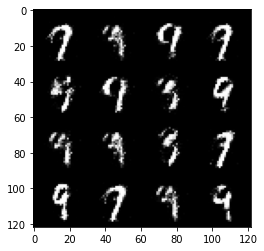

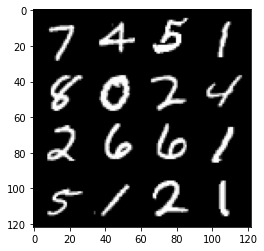

 49%|████▉     | 230/469 [00:06<00:10, 21.98it/s]

75: step 35400 / Gen loss: 4.040516655445102 / disc_loss: 0.09371325788398581


 12%|█▏        | 56/469 [00:01<00:10, 37.84it/s]

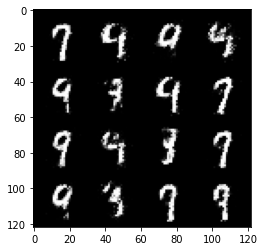

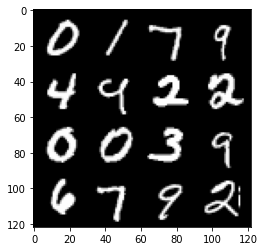

 14%|█▎        | 64/469 [00:02<00:19, 21.22it/s]

76: step 35700 / Gen loss: 3.9290791106224043 / disc_loss: 0.09851183823620276


 76%|███████▌  | 355/469 [00:09<00:02, 39.37it/s]

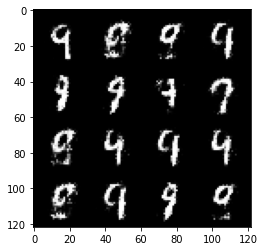

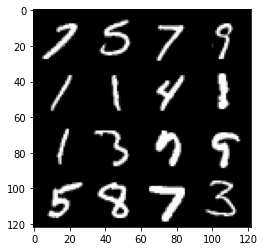

 78%|███████▊  | 364/469 [00:10<00:04, 23.20it/s]

76: step 36000 / Gen loss: 4.304630666573842 / disc_loss: 0.0725634700184067


 40%|███▉      | 186/469 [00:04<00:07, 39.37it/s]

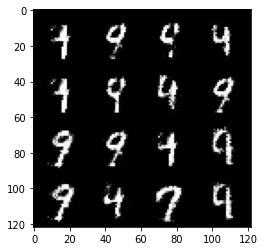

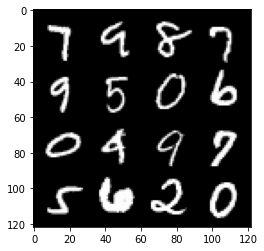

 41%|████▏     | 194/469 [00:05<00:12, 22.04it/s]

77: step 36300 / Gen loss: 4.107906470298768 / disc_loss: 0.08698475615431867


  3%|▎         | 14/469 [00:00<00:11, 41.23it/s]

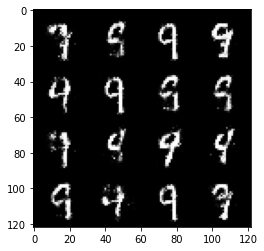

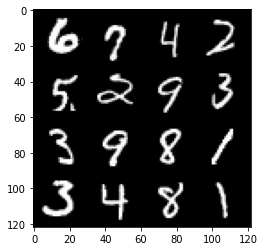

  5%|▍         | 23/469 [00:00<00:20, 21.93it/s]

78: step 36600 / Gen loss: 4.006327811082205 / disc_loss: 0.09326157691578077


 67%|██████▋   | 315/469 [00:08<00:03, 39.50it/s]

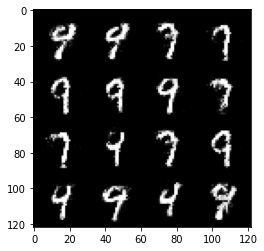

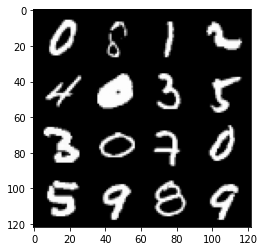

 69%|██████▉   | 323/469 [00:09<00:07, 20.55it/s]

78: step 36900 / Gen loss: 3.974283987681069 / disc_loss: 0.08969767683496073


 31%|███       | 146/469 [00:03<00:08, 38.82it/s]

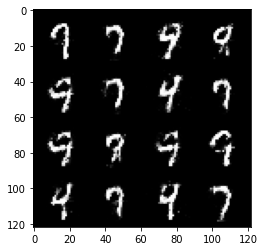

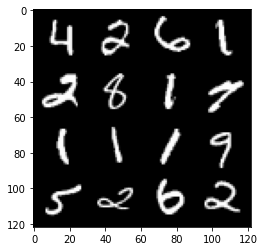

 33%|███▎      | 154/469 [00:04<00:13, 22.97it/s]

79: step 37200 / Gen loss: 3.834299345811206 / disc_loss: 0.0935687567728261


 96%|█████████▌| 448/469 [00:11<00:00, 37.13it/s]

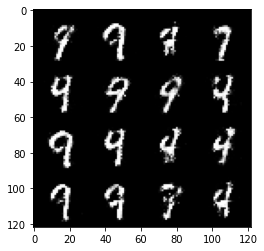

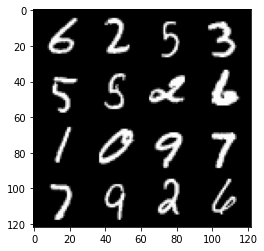

 97%|█████████▋| 456/469 [00:12<00:00, 22.33it/s]

79: step 37500 / Gen loss: 4.260777323246001 / disc_loss: 0.08398890165612095


 59%|█████▉    | 277/469 [00:07<00:05, 38.02it/s]

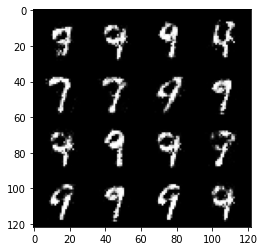

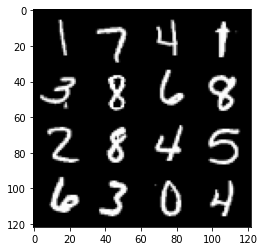

 61%|██████    | 285/469 [00:07<00:08, 22.67it/s]

80: step 37800 / Gen loss: 3.9636000235875466 / disc_loss: 0.10165329611549784


 23%|██▎       | 110/469 [00:03<00:09, 38.79it/s]

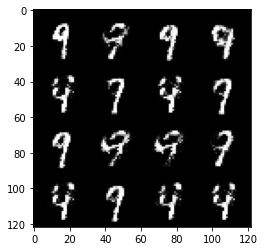

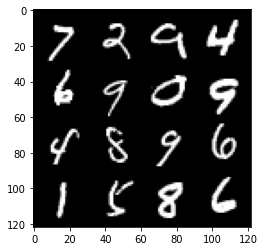

 25%|██▌       | 119/469 [00:03<00:15, 22.67it/s]

81: step 38100 / Gen loss: 3.6476514331499694 / disc_loss: 0.13035097678502408


 88%|████████▊ | 411/469 [00:11<00:01, 37.29it/s]

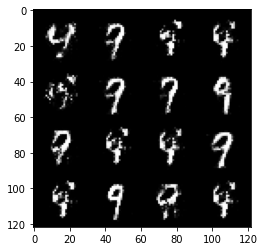

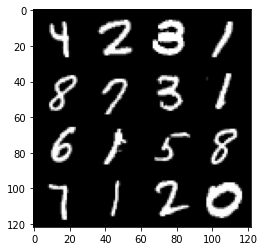

 89%|████████▉ | 419/469 [00:12<00:02, 21.96it/s]

81: step 38400 / Gen loss: 3.6565482338269564 / disc_loss: 0.12966701034456485


 51%|█████     | 239/469 [00:06<00:05, 38.83it/s]

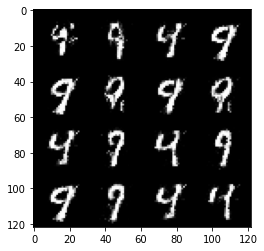

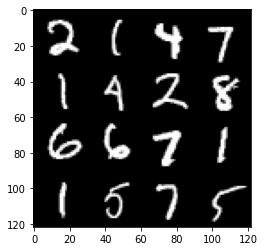

 53%|█████▎    | 247/469 [00:06<00:09, 22.57it/s]

82: step 38700 / Gen loss: 3.835714964866641 / disc_loss: 0.11388415810962522


 15%|█▌        | 72/469 [00:01<00:10, 38.52it/s]

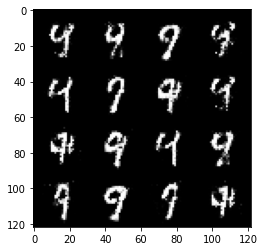

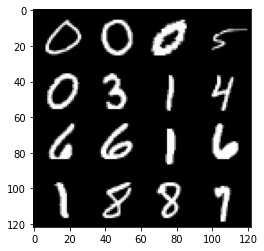

 17%|█▋        | 80/469 [00:02<00:16, 23.13it/s]

83: step 39000 / Gen loss: 3.913240691026055 / disc_loss: 0.0925923106012246


 79%|███████▉  | 372/469 [00:09<00:02, 38.16it/s]

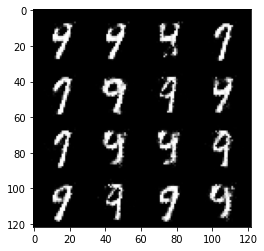

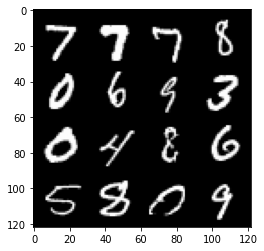

 81%|████████  | 380/469 [00:10<00:04, 19.57it/s]

83: step 39300 / Gen loss: 4.186731518904368 / disc_loss: 0.08407620707526804


 43%|████▎     | 202/469 [00:05<00:06, 39.47it/s]

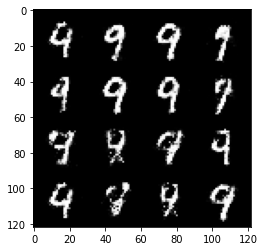

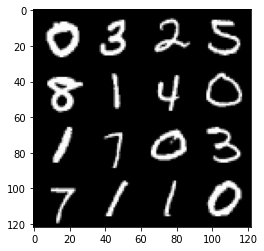

 45%|████▍     | 211/469 [00:05<00:10, 24.02it/s]

84: step 39600 / Gen loss: 3.869289091428124 / disc_loss: 0.10093693268795804


  7%|▋         | 32/469 [00:00<00:11, 37.82it/s]

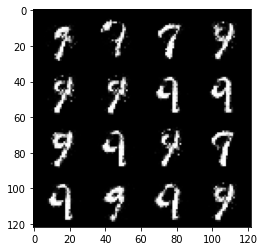

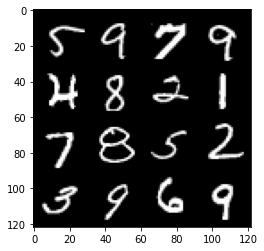

  9%|▊         | 40/469 [00:01<00:19, 22.10it/s]

85: step 39900 / Gen loss: 3.8426478679974894 / disc_loss: 0.11068056373546518


 71%|███████   | 331/469 [00:08<00:03, 41.24it/s]

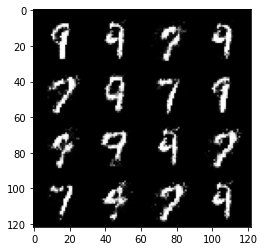

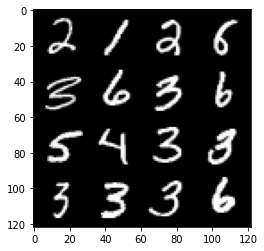

 72%|███████▏  | 340/469 [00:09<00:05, 23.72it/s]

85: step 40200 / Gen loss: 3.8658335638046255 / disc_loss: 0.10403955178956195


 35%|███▌      | 165/469 [00:04<00:07, 38.88it/s]

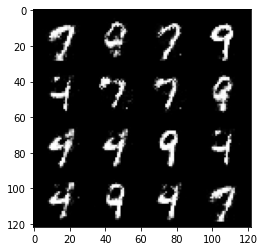

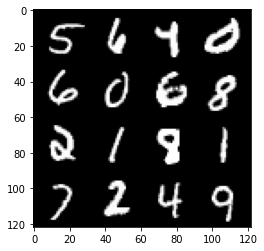

 37%|███▋      | 173/469 [00:04<00:12, 23.11it/s]

86: step 40500 / Gen loss: 4.015049535433451 / disc_loss: 0.09676196113228797


 99%|█████████▉| 466/469 [00:12<00:00, 38.71it/s]

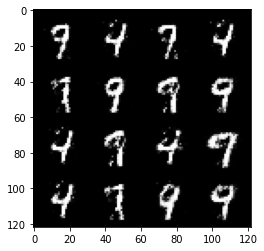

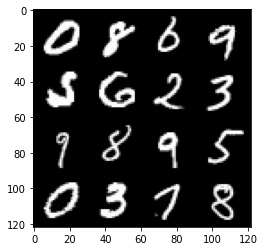

100%|██████████| 469/469 [00:12<00:00, 37.01it/s]


86: step 40800 / Gen loss: 3.7532903957366957 / disc_loss: 0.10792155858129272


 63%|██████▎   | 295/469 [00:07<00:04, 39.12it/s]

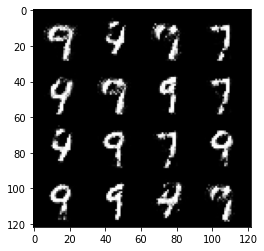

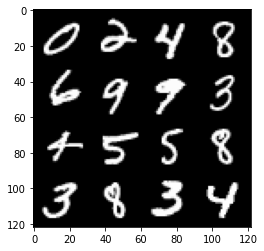

 65%|██████▍   | 303/469 [00:08<00:07, 21.87it/s]

87: step 41100 / Gen loss: 3.906681270599365 / disc_loss: 0.10708738560477891


 27%|██▋       | 128/469 [00:03<00:08, 38.80it/s]

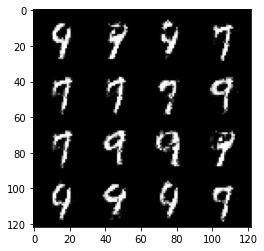

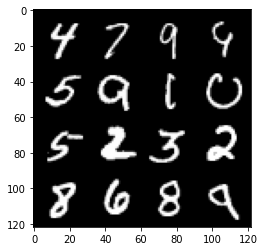

 29%|██▉       | 136/469 [00:03<00:15, 22.02it/s]

88: step 41400 / Gen loss: 3.889140808582307 / disc_loss: 0.10314253837491068


 91%|█████████ | 426/469 [00:11<00:01, 39.43it/s]

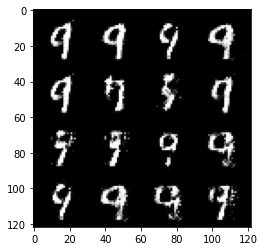

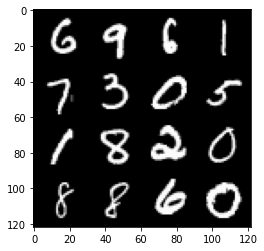

 93%|█████████▎| 435/469 [00:11<00:01, 21.64it/s]

88: step 41700 / Gen loss: 3.8004348651568085 / disc_loss: 0.09962295039246487


 55%|█████▌    | 259/469 [00:06<00:05, 40.30it/s]

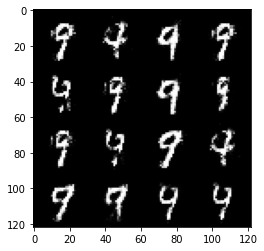

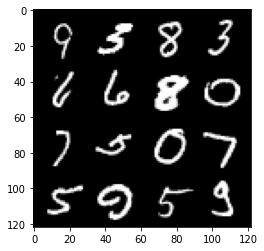

 56%|█████▋    | 264/469 [00:06<00:09, 21.69it/s]

89: step 42000 / Gen loss: 4.0574307417869555 / disc_loss: 0.0879529430096348


 19%|█▊        | 87/469 [00:02<00:09, 38.31it/s]

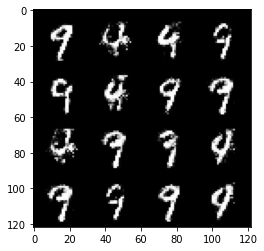

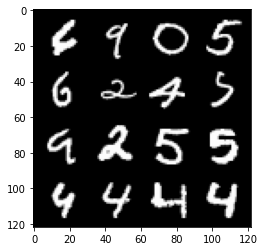

 20%|██        | 96/469 [00:02<00:16, 23.29it/s]

90: step 42300 / Gen loss: 3.8359410436948145 / disc_loss: 0.10634616239617266


 83%|████████▎ | 388/469 [00:10<00:02, 39.32it/s]

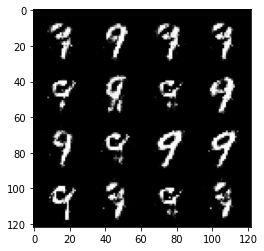

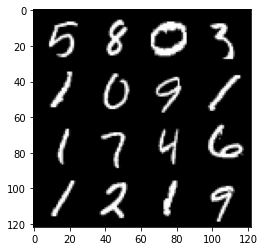

 85%|████████▍ | 397/469 [00:10<00:02, 24.43it/s]

90: step 42600 / Gen loss: 3.7761907116572044 / disc_loss: 0.09945752997572231


 46%|████▋     | 218/469 [00:05<00:06, 39.54it/s]

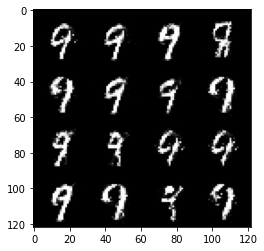

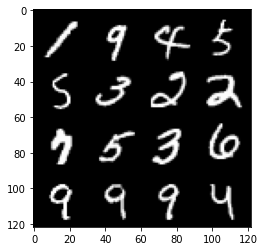

 48%|████▊     | 226/469 [00:06<00:10, 22.75it/s]

91: step 42900 / Gen loss: 3.9789153663317345 / disc_loss: 0.09149085255960629


 11%|█         | 51/469 [00:01<00:10, 39.22it/s]

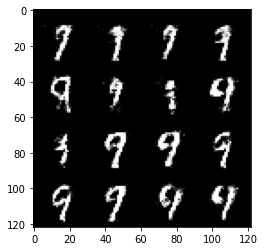

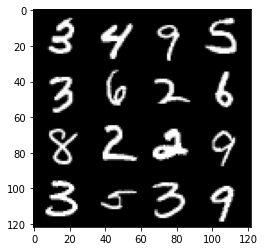

 13%|█▎        | 59/469 [00:01<00:18, 22.33it/s]

92: step 43200 / Gen loss: 3.9071368749936415 / disc_loss: 0.09126407072568939


 74%|███████▍  | 349/469 [00:09<00:03, 39.21it/s]

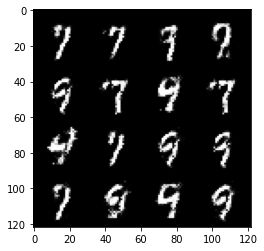

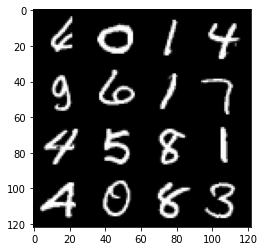

 76%|███████▌  | 357/469 [00:09<00:04, 23.27it/s]

92: step 43500 / Gen loss: 3.8837926634152757 / disc_loss: 0.09600336027642088


 38%|███▊      | 180/469 [00:04<00:07, 39.54it/s]

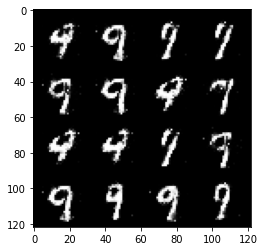

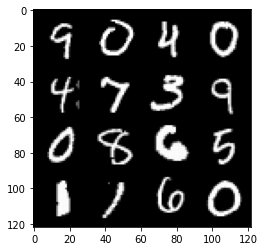

 40%|████      | 189/469 [00:05<00:11, 24.51it/s]

93: step 43800 / Gen loss: 3.9416340422630314 / disc_loss: 0.09771207685271904


  3%|▎         | 14/469 [00:00<00:11, 39.17it/s]

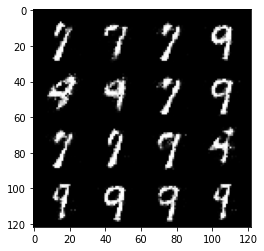

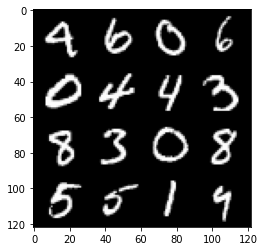

  5%|▍         | 22/469 [00:01<00:23, 18.75it/s]

94: step 44100 / Gen loss: 3.999503196875253 / disc_loss: 0.09325805542990562


 67%|██████▋   | 314/469 [00:08<00:04, 38.49it/s]

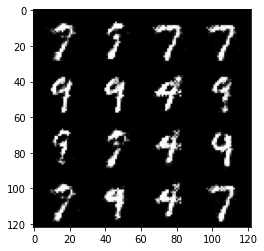

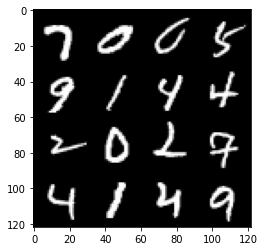

 69%|██████▊   | 322/469 [00:09<00:06, 22.24it/s]

94: step 44400 / Gen loss: 3.8692654705047613 / disc_loss: 0.10662983663380143


 30%|███       | 142/469 [00:03<00:08, 39.88it/s]

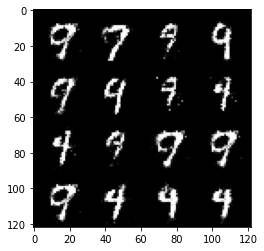

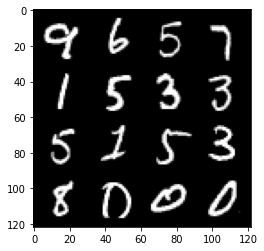

 32%|███▏      | 150/469 [00:04<00:13, 23.41it/s]

95: step 44700 / Gen loss: 3.929352187315623 / disc_loss: 0.08640234199042125


 94%|█████████▍| 443/469 [00:11<00:00, 38.34it/s]

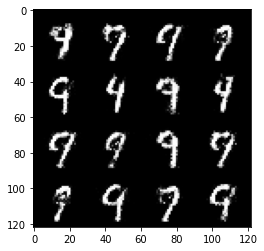

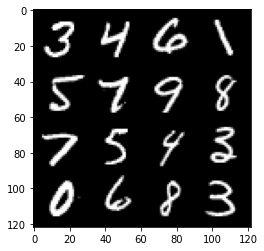

 96%|█████████▌| 451/469 [00:12<00:00, 22.94it/s]

95: step 45000 / Gen loss: 4.027629930973049 / disc_loss: 0.0871837188738088


 59%|█████▊    | 275/469 [00:07<00:04, 39.76it/s]

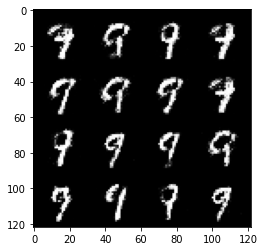

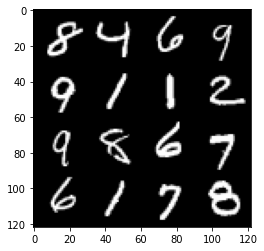

 60%|██████    | 283/469 [00:07<00:08, 23.03it/s]

96: step 45300 / Gen loss: 3.5985636234283436 / disc_loss: 0.12765063811093563


 23%|██▎       | 107/469 [00:02<00:09, 38.48it/s]

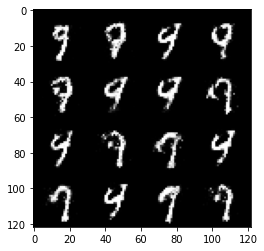

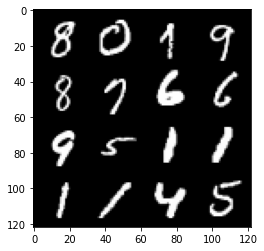

 25%|██▍       | 115/469 [00:03<00:16, 22.01it/s]

97: step 45600 / Gen loss: 3.686632564862569 / disc_loss: 0.11768902952472372


 86%|████████▋ | 405/469 [00:10<00:01, 39.23it/s]

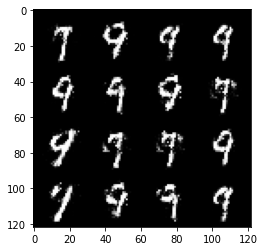

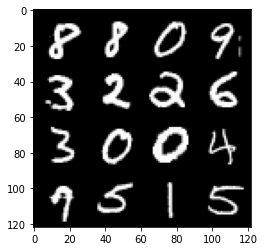

 88%|████████▊ | 413/469 [00:11<00:02, 23.98it/s]

97: step 45900 / Gen loss: 3.6193165914217618 / disc_loss: 0.1308423305054506


 51%|█████     | 238/469 [00:06<00:05, 39.04it/s]

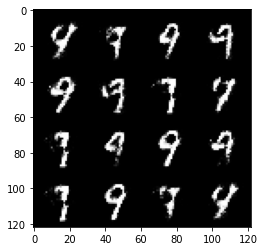

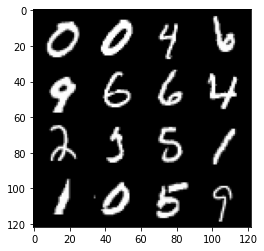

 52%|█████▏    | 246/469 [00:06<00:09, 22.47it/s]

98: step 46200 / Gen loss: 3.437601819038388 / disc_loss: 0.12611861005425457


 15%|█▍        | 69/469 [00:01<00:10, 39.38it/s]

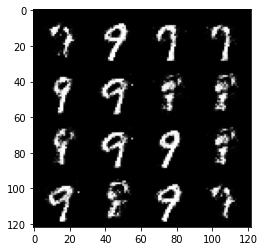

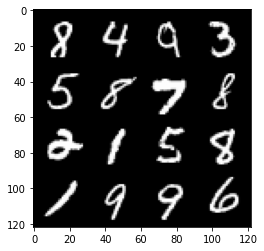

 16%|█▋        | 77/469 [00:02<00:18, 20.98it/s]

99: step 46500 / Gen loss: 3.88029725074768 / disc_loss: 0.10435876873632279


 78%|███████▊  | 365/469 [00:09<00:02, 39.58it/s]

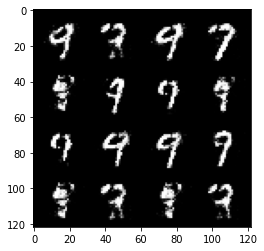

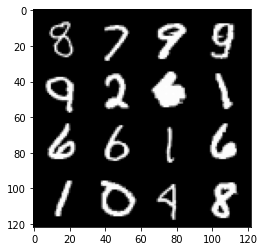

 80%|███████▉  | 374/469 [00:10<00:03, 24.51it/s]

99: step 46800 / Gen loss: 3.674341366291045 / disc_loss: 0.10034297816455368


 43%|████▎     | 200/469 [00:05<00:07, 37.56it/s]

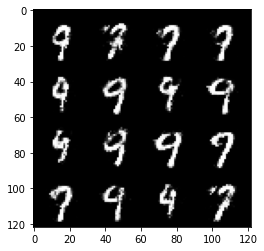

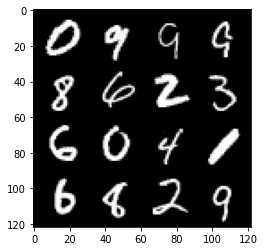

 43%|████▎     | 204/469 [00:05<00:15, 16.62it/s]

100: step 47100 / Gen loss: 3.669491801261901 / disc_loss: 0.10584597362826267


  6%|▋         | 30/469 [00:00<00:11, 39.29it/s]

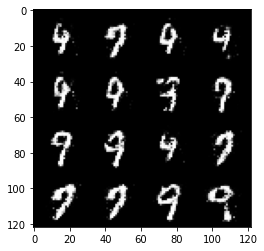

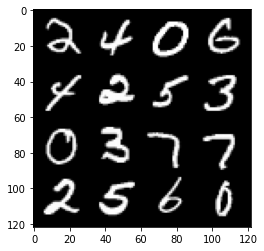

  8%|▊         | 38/469 [00:01<00:19, 22.35it/s]

101: step 47400 / Gen loss: 3.6072946166992192 / disc_loss: 0.11436210611214238


 70%|███████   | 329/469 [00:08<00:03, 37.86it/s]

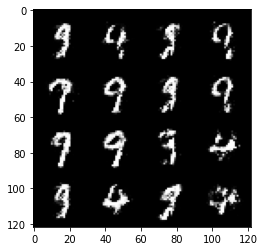

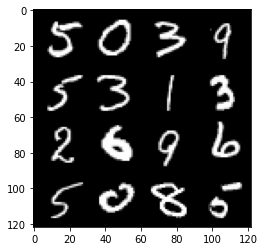

 72%|███████▏  | 337/469 [00:09<00:06, 21.80it/s]

101: step 47700 / Gen loss: 3.8464676570892338 / disc_loss: 0.09801019575446852


 34%|███▎      | 158/469 [00:04<00:07, 40.48it/s]

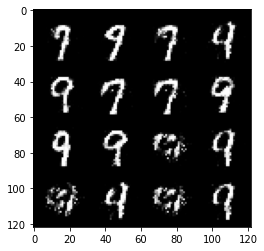

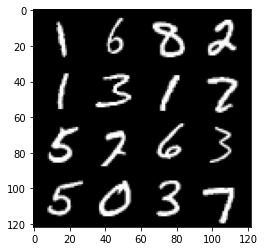

 36%|███▌      | 167/469 [00:04<00:12, 24.45it/s]

102: step 48000 / Gen loss: 3.6853985428810114 / disc_loss: 0.11359234680732085


 98%|█████████▊| 460/469 [00:11<00:00, 39.49it/s]

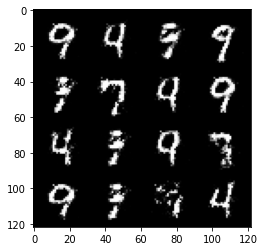

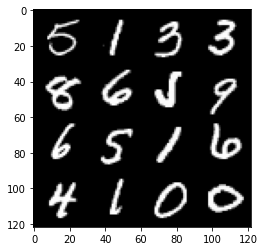

100%|██████████| 469/469 [00:12<00:00, 37.48it/s]


102: step 48300 / Gen loss: 3.5680022271474208 / disc_loss: 0.1127891531089941


 62%|██████▏   | 290/469 [00:07<00:04, 38.56it/s]

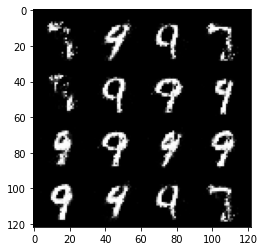

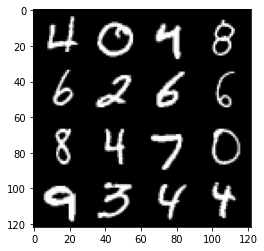

 64%|██████▎   | 298/469 [00:07<00:07, 22.58it/s]

103: step 48600 / Gen loss: 3.5321467789014185 / disc_loss: 0.11660865696767965


 26%|██▌       | 120/469 [00:03<00:09, 38.71it/s]

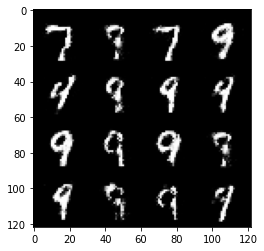

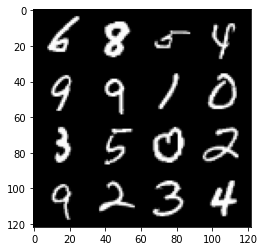

 28%|██▊       | 129/469 [00:03<00:16, 20.53it/s]

104: step 48900 / Gen loss: 3.6853241920471222 / disc_loss: 0.10831882897764446


 90%|████████▉ | 421/469 [00:11<00:01, 38.31it/s]

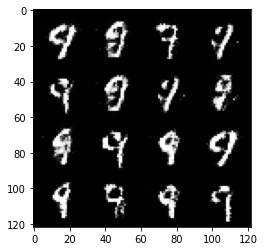

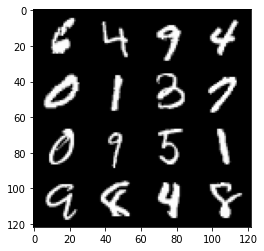

 91%|█████████▏| 429/469 [00:11<00:01, 21.67it/s]

104: step 49200 / Gen loss: 3.3126694822311396 / disc_loss: 0.14107434750845033


 54%|█████▎    | 252/469 [00:06<00:05, 38.90it/s]

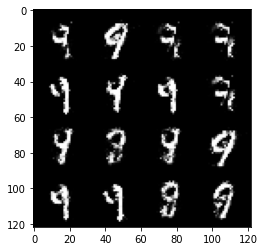

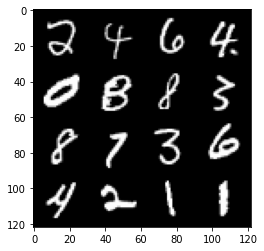

 55%|█████▌    | 260/469 [00:07<00:09, 22.56it/s]

105: step 49500 / Gen loss: 3.3713319802284265 / disc_loss: 0.13243604920804505


 18%|█▊        | 83/469 [00:02<00:09, 39.67it/s]

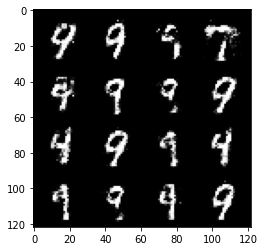

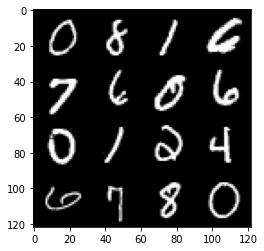

 19%|█▉        | 91/469 [00:02<00:15, 24.05it/s]

106: step 49800 / Gen loss: 3.564382896423341 / disc_loss: 0.12402789007872343


 82%|████████▏ | 384/469 [00:10<00:02, 38.55it/s]

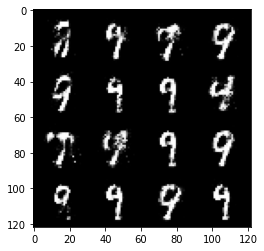

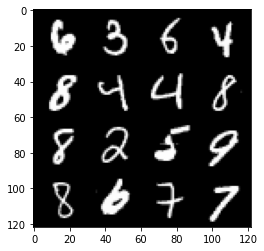

 84%|████████▎ | 392/469 [00:10<00:03, 22.04it/s]

106: step 50100 / Gen loss: 3.272689824104308 / disc_loss: 0.1498133376737436


 46%|████▌     | 215/469 [00:05<00:06, 38.86it/s]

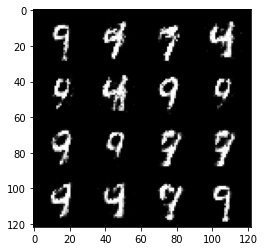

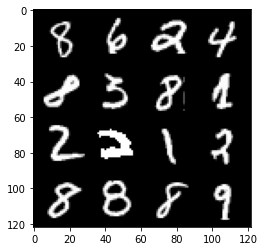

 48%|████▊     | 223/469 [00:06<00:11, 21.76it/s]

107: step 50400 / Gen loss: 3.391851372718813 / disc_loss: 0.11819132485737413


 10%|▉         | 46/469 [00:01<00:10, 40.42it/s]

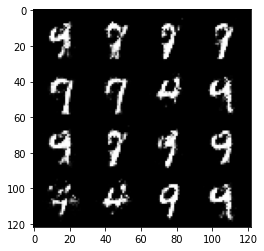

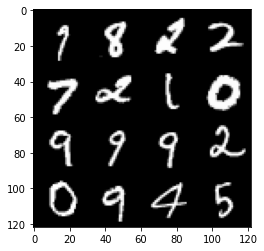

 12%|█▏        | 56/469 [00:01<00:16, 24.72it/s]

108: step 50700 / Gen loss: 3.3983387231826807 / disc_loss: 0.13390407805641488


 74%|███████▍  | 346/469 [00:09<00:03, 40.81it/s]

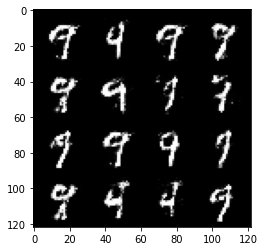

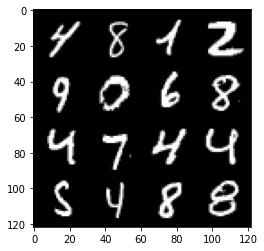

 76%|███████▌  | 356/469 [00:09<00:04, 25.33it/s]

108: step 51000 / Gen loss: 3.3376333379745513 / disc_loss: 0.15438975296914578


 38%|███▊      | 176/469 [00:04<00:07, 39.93it/s]

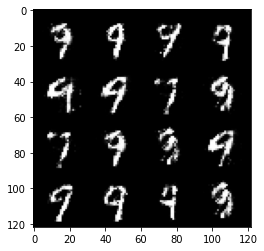

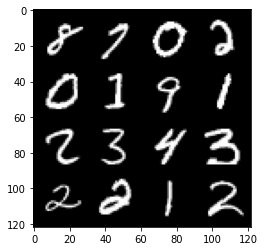

 39%|███▉      | 184/469 [00:05<00:13, 20.59it/s]

109: step 51300 / Gen loss: 3.414247895081839 / disc_loss: 0.12418649324526379


  2%|▏         | 9/469 [00:00<00:11, 39.76it/s]

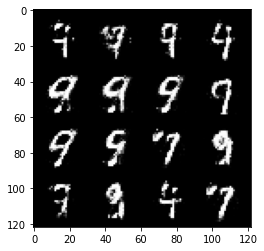

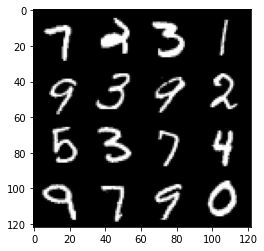

  4%|▍         | 18/469 [00:00<00:20, 21.62it/s]

110: step 51600 / Gen loss: 3.246623989741008 / disc_loss: 0.14671162158250803


 65%|██████▌   | 306/469 [00:07<00:04, 40.50it/s]

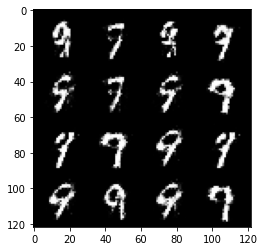

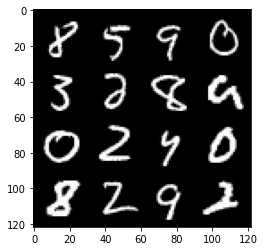

 67%|██████▋   | 315/469 [00:08<00:06, 24.16it/s]

110: step 51900 / Gen loss: 3.3568966468175225 / disc_loss: 0.1321398112426201


 30%|███       | 141/469 [00:03<00:08, 39.52it/s]

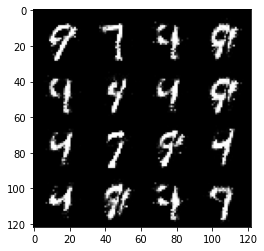

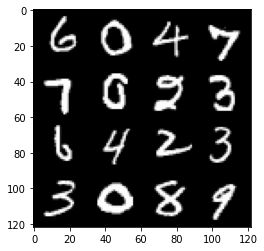

 32%|███▏      | 149/469 [00:04<00:13, 23.27it/s]

111: step 52200 / Gen loss: 3.090791352589926 / disc_loss: 0.15563877803583936


 94%|█████████▍| 440/469 [00:11<00:00, 36.17it/s]

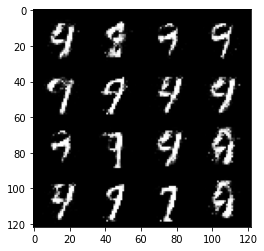

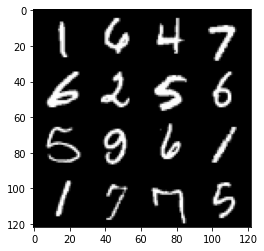

 96%|█████████▌| 448/469 [00:12<00:00, 22.19it/s]

111: step 52500 / Gen loss: 3.4395327536265072 / disc_loss: 0.11630709495395417


 57%|█████▋    | 269/469 [00:06<00:05, 39.40it/s]

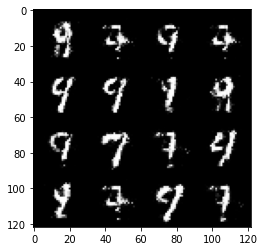

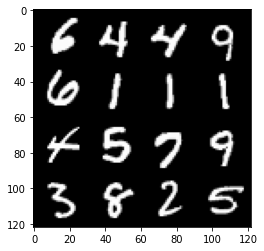

 59%|█████▉    | 277/469 [00:07<00:08, 22.93it/s]

112: step 52800 / Gen loss: 3.517283031940461 / disc_loss: 0.11553715379287803


 22%|██▏       | 102/469 [00:02<00:09, 38.71it/s]

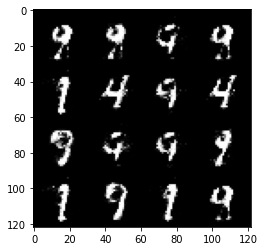

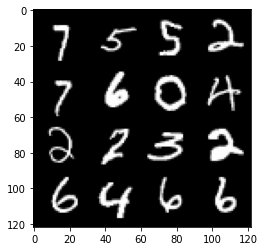

 23%|██▎       | 110/469 [00:03<00:16, 22.05it/s]

113: step 53100 / Gen loss: 3.4229219730695073 / disc_loss: 0.1207643692816297


 86%|████████▌ | 403/469 [00:10<00:01, 37.61it/s]

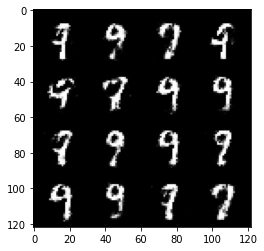

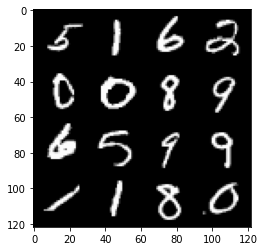

 88%|████████▊ | 411/469 [00:11<00:02, 21.64it/s]

113: step 53400 / Gen loss: 3.3441710813840255 / disc_loss: 0.126899632140994


 49%|████▉     | 232/469 [00:06<00:06, 38.06it/s]

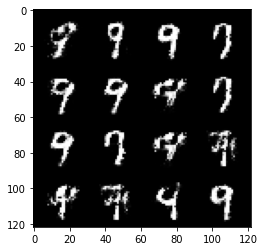

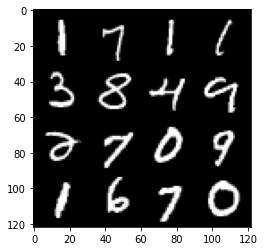

 51%|█████     | 240/469 [00:06<00:11, 19.94it/s]

114: step 53700 / Gen loss: 3.3749453330039976 / disc_loss: 0.13253288471450403


 14%|█▎        | 64/469 [00:01<00:10, 38.16it/s]

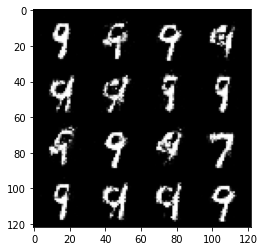

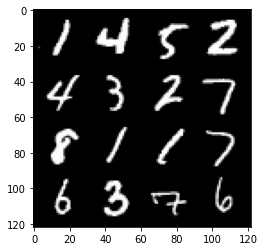

 15%|█▌        | 72/469 [00:02<00:18, 22.04it/s]

115: step 54000 / Gen loss: 3.260354952017471 / disc_loss: 0.1401828707630437


 77%|███████▋  | 362/469 [00:09<00:02, 36.06it/s]

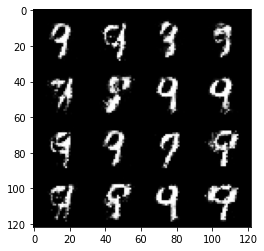

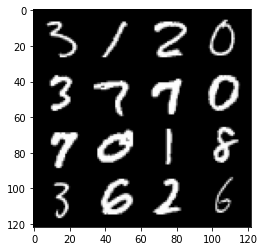

 79%|███████▉  | 370/469 [00:10<00:04, 22.26it/s]

115: step 54300 / Gen loss: 3.3272243030865964 / disc_loss: 0.13531075008213528


 41%|████      | 193/469 [00:04<00:07, 37.90it/s]

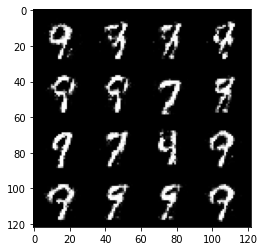

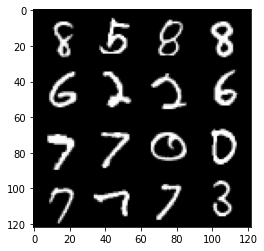

 43%|████▎     | 202/469 [00:05<00:11, 23.38it/s]

116: step 54600 / Gen loss: 3.3475087181727066 / disc_loss: 0.123607980882128


  5%|▌         | 25/469 [00:00<00:11, 39.46it/s]

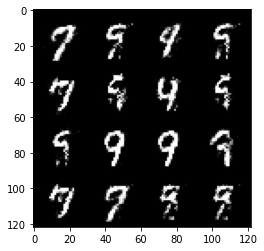

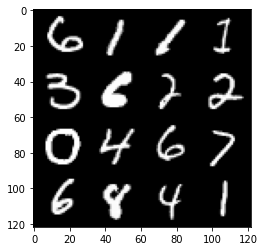

  7%|▋         | 33/469 [00:01<00:19, 22.68it/s]

117: step 54900 / Gen loss: 3.239065095583597 / disc_loss: 0.1383545322467883


 70%|██████▉   | 326/469 [00:08<00:03, 36.47it/s]

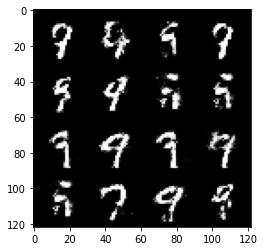

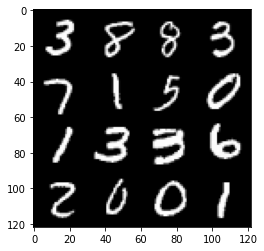

 71%|███████   | 334/469 [00:09<00:06, 21.81it/s]

117: step 55200 / Gen loss: 3.1621976923942574 / disc_loss: 0.14516341028114157


 33%|███▎      | 156/469 [00:04<00:08, 36.17it/s]

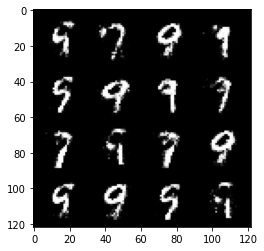

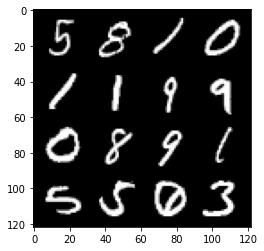

 35%|███▍      | 164/469 [00:04<00:14, 20.72it/s]

118: step 55500 / Gen loss: 3.116130964756011 / disc_loss: 0.14656115292261054


 97%|█████████▋| 456/469 [00:12<00:00, 38.81it/s]

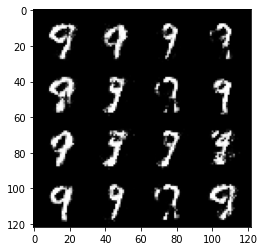

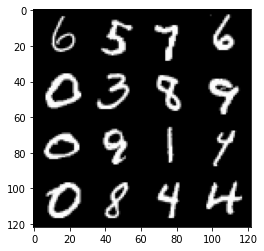

 99%|█████████▉| 464/469 [00:12<00:00, 21.12it/s]

118: step 55800 / Gen loss: 3.064172506332396 / disc_loss: 0.15800705653925737


 61%|██████    | 286/469 [00:08<00:04, 37.60it/s]

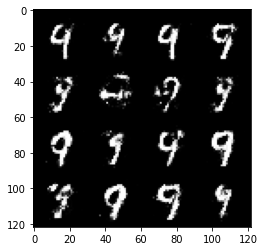

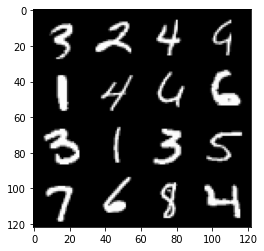

 63%|██████▎   | 294/469 [00:09<00:09, 19.42it/s]

119: step 56100 / Gen loss: 3.0501071317990593 / disc_loss: 0.15350621312856674


 25%|██▌       | 119/469 [00:03<00:08, 39.37it/s]

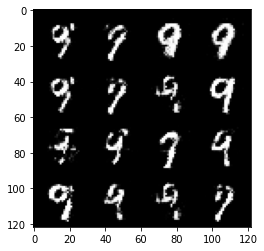

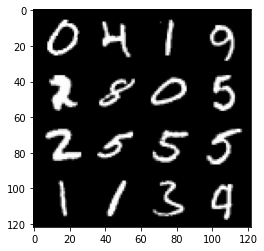

 27%|██▋       | 127/469 [00:03<00:15, 22.21it/s]

120: step 56400 / Gen loss: 3.21499462922414 / disc_loss: 0.13524868828554948


 89%|████████▉ | 419/469 [00:11<00:01, 40.13it/s]

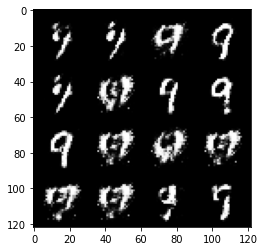

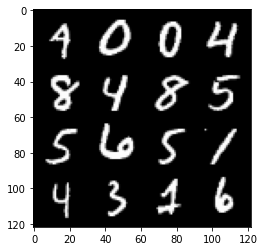

 91%|█████████▏| 428/469 [00:11<00:01, 23.51it/s]

120: step 56700 / Gen loss: 3.127901149590809 / disc_loss: 0.16159345664083966


 53%|█████▎    | 250/469 [00:06<00:05, 39.92it/s]

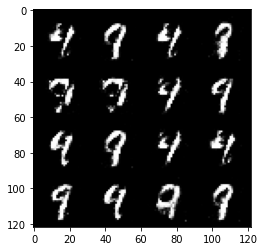

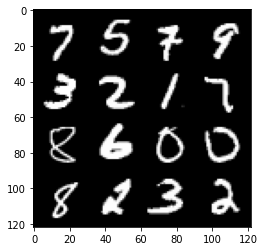

 55%|█████▌    | 259/469 [00:07<00:08, 23.64it/s]

121: step 57000 / Gen loss: 3.1404465945561695 / disc_loss: 0.1556375241776308


 17%|█▋        | 82/469 [00:02<00:10, 38.34it/s]

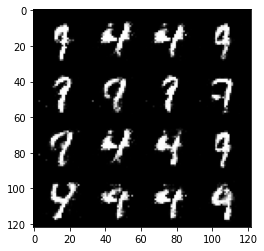

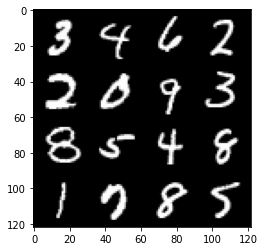

 19%|█▉        | 90/469 [00:02<00:17, 21.90it/s]

122: step 57300 / Gen loss: 3.2079585480689996 / disc_loss: 0.1461977809667586


 81%|████████▏ | 382/469 [00:10<00:02, 37.98it/s]

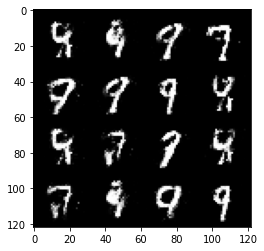

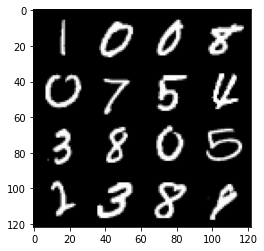

 83%|████████▎ | 391/469 [00:10<00:03, 23.71it/s]

122: step 57600 / Gen loss: 3.284309646288554 / disc_loss: 0.1412956449389458


 45%|████▍     | 210/469 [00:05<00:06, 39.10it/s]

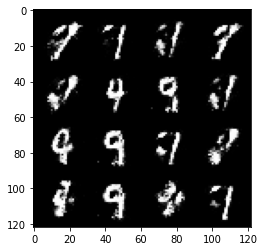

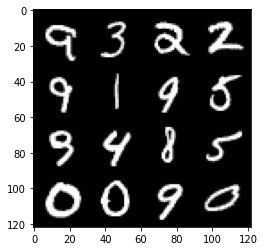

 46%|████▋     | 218/469 [00:05<00:10, 23.55it/s]

123: step 57900 / Gen loss: 3.1908942723274243 / disc_loss: 0.1481546368201574


  9%|▊         | 41/469 [00:01<00:10, 40.57it/s]

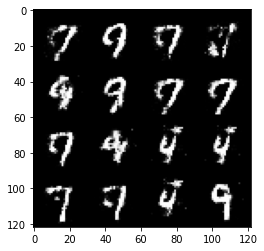

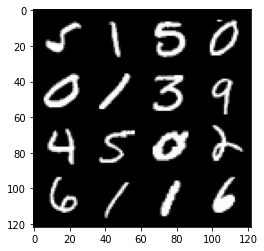

 11%|█         | 51/469 [00:01<00:16, 25.21it/s]

124: step 58200 / Gen loss: 3.214981354077657 / disc_loss: 0.14678468152880672


 73%|███████▎  | 341/469 [00:08<00:03, 39.37it/s]

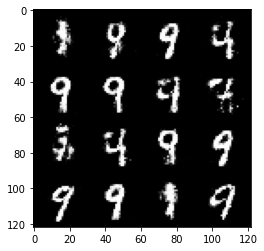

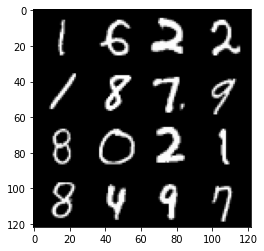

 74%|███████▍  | 349/469 [00:09<00:05, 20.45it/s]

124: step 58500 / Gen loss: 3.3617527858416234 / disc_loss: 0.141472605317831


 37%|███▋      | 174/469 [00:04<00:07, 39.31it/s]

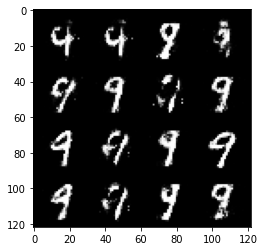

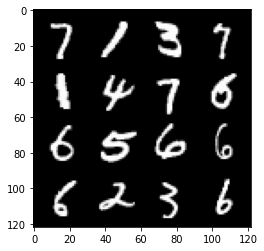

 39%|███▉      | 183/469 [00:05<00:12, 23.83it/s]

125: step 58800 / Gen loss: 3.1628922017415384 / disc_loss: 0.14856297935048726


  1%|          | 4/469 [00:00<00:12, 36.39it/s]

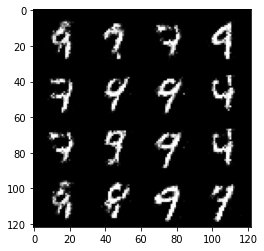

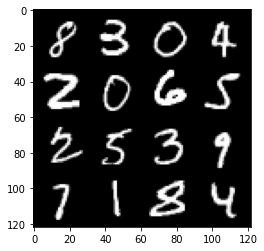

  3%|▎         | 13/469 [00:00<00:23, 19.59it/s]

126: step 59100 / Gen loss: 3.1110008692741373 / disc_loss: 0.14149056912710273


 65%|██████▍   | 304/469 [00:08<00:04, 39.02it/s]

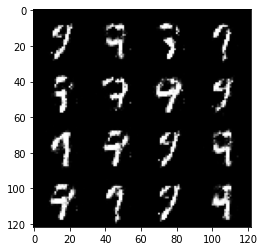

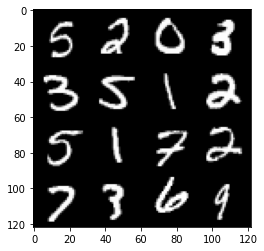

 67%|██████▋   | 312/469 [00:08<00:07, 21.99it/s]

126: step 59400 / Gen loss: 2.9091092507044456 / disc_loss: 0.15258362588783103


 29%|██▉       | 137/469 [00:03<00:08, 38.21it/s]

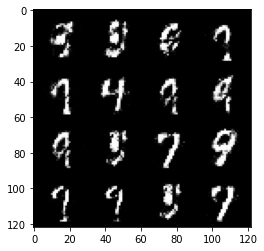

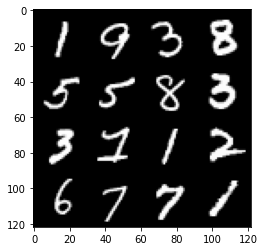

 31%|███       | 145/469 [00:04<00:14, 22.08it/s]

127: step 59700 / Gen loss: 2.888386620680493 / disc_loss: 0.16580886465807754


 93%|█████████▎| 437/469 [00:11<00:00, 38.31it/s]

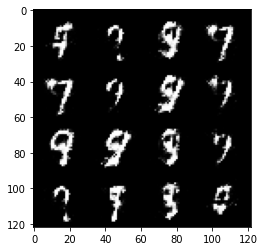

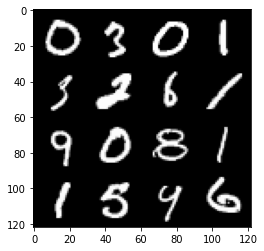

 95%|█████████▍| 445/469 [00:12<00:01, 22.94it/s]

127: step 60000 / Gen loss: 3.2084415705998715 / disc_loss: 0.1365548480053743


 57%|█████▋    | 265/469 [00:06<00:05, 39.75it/s]

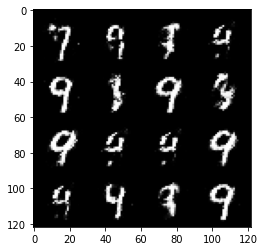

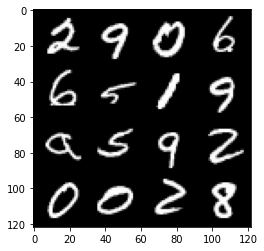

 58%|█████▊    | 273/469 [00:07<00:08, 23.04it/s]

128: step 60300 / Gen loss: 3.0230195959409074 / disc_loss: 0.1572244467958808


 21%|██        | 97/469 [00:02<00:09, 38.26it/s]

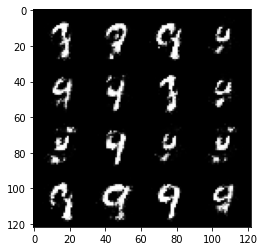

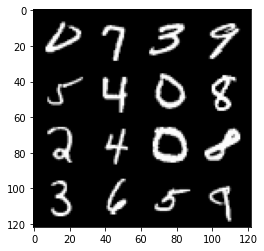

 22%|██▏       | 105/469 [00:03<00:16, 21.87it/s]

129: step 60600 / Gen loss: 2.950244437058764 / disc_loss: 0.18589300473531079


 85%|████████▍ | 397/469 [00:10<00:01, 38.68it/s]

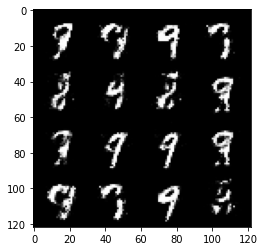

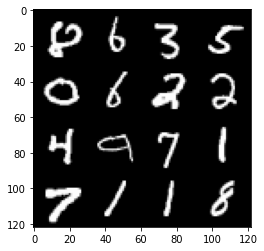

 87%|████████▋ | 406/469 [00:11<00:02, 21.12it/s]

129: step 60900 / Gen loss: 3.03981282711029 / disc_loss: 0.1600965975721678


 49%|████▉     | 230/469 [00:05<00:06, 38.97it/s]

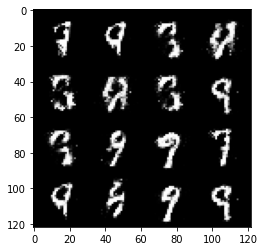

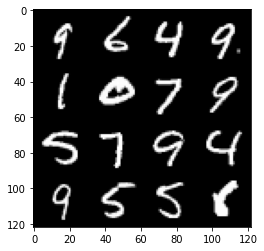

 51%|█████     | 238/469 [00:06<00:10, 22.63it/s]

130: step 61200 / Gen loss: 3.139825857480367 / disc_loss: 0.14674547354380288


 12%|█▏        | 58/469 [00:01<00:10, 39.10it/s]

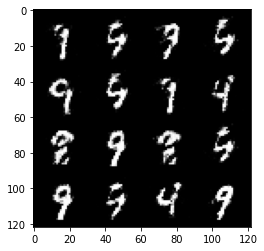

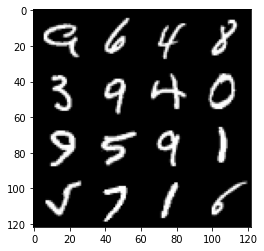

 14%|█▍        | 66/469 [00:02<00:17, 22.83it/s]

131: step 61500 / Gen loss: 3.033658541838326 / disc_loss: 0.1612672844032447


 77%|███████▋  | 360/469 [00:09<00:02, 39.34it/s]

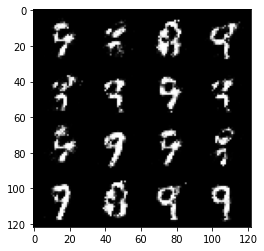

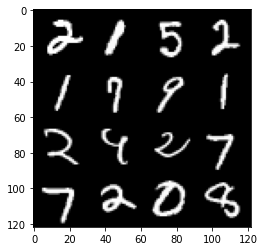

 78%|███████▊  | 368/469 [00:10<00:04, 22.71it/s]

131: step 61800 / Gen loss: 2.98921716372172 / disc_loss: 0.16297562167048465


 41%|████      | 190/469 [00:04<00:07, 39.21it/s]

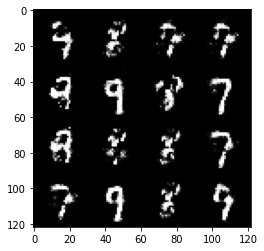

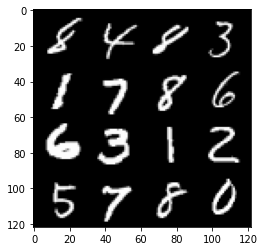

 42%|████▏     | 198/469 [00:05<00:12, 22.48it/s]

132: step 62100 / Gen loss: 3.0220568474133804 / disc_loss: 0.15267195414751766


  4%|▍         | 20/469 [00:00<00:11, 38.31it/s]

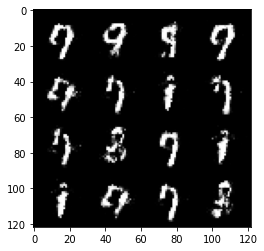

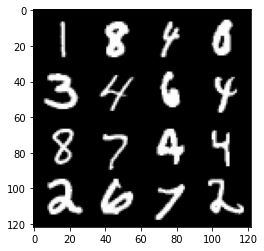

  6%|▌         | 28/469 [00:01<00:20, 21.78it/s]

133: step 62400 / Gen loss: 3.033245697816212 / disc_loss: 0.15755917735397823


 69%|██████▉   | 323/469 [00:08<00:03, 37.59it/s]

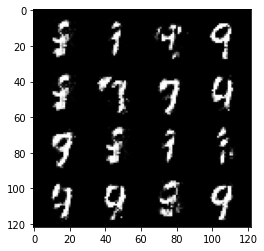

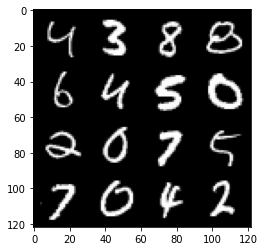

 70%|██████▉   | 327/469 [00:09<00:07, 18.91it/s]

133: step 62700 / Gen loss: 3.022889931996664 / disc_loss: 0.15051602313915885


 32%|███▏      | 151/469 [00:03<00:08, 39.41it/s]

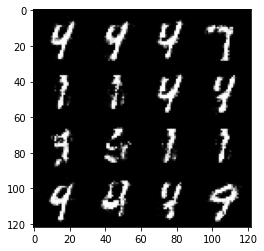

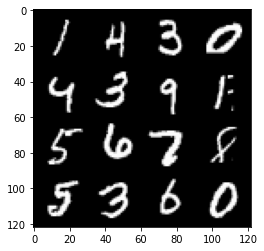

 34%|███▍      | 159/469 [00:04<00:13, 23.54it/s]

134: step 63000 / Gen loss: 3.062131253878276 / disc_loss: 0.14541003825763862


 97%|█████████▋| 453/469 [00:11<00:00, 38.32it/s]

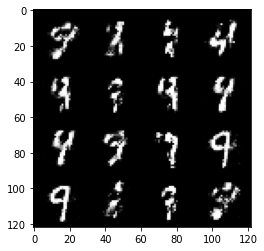

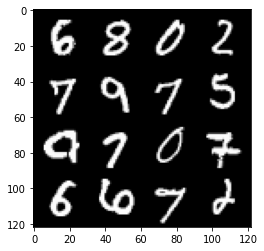

 98%|█████████▊| 461/469 [00:12<00:00, 20.40it/s]

134: step 63300 / Gen loss: 2.9007671435674043 / disc_loss: 0.1856914752721786


 61%|██████    | 284/469 [00:07<00:04, 40.05it/s]

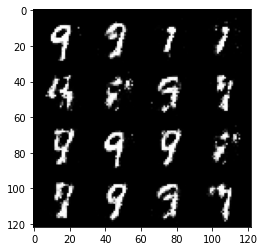

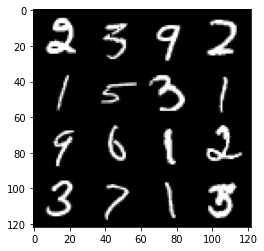

 62%|██████▏   | 293/469 [00:07<00:07, 24.34it/s]

135: step 63600 / Gen loss: 2.7448658108711257 / disc_loss: 0.19138443606595207


 25%|██▍       | 116/469 [00:02<00:09, 38.11it/s]

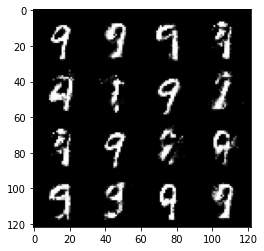

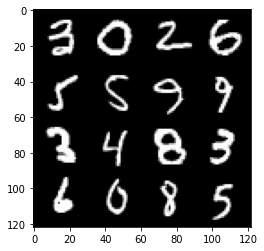

 27%|██▋       | 125/469 [00:03<00:14, 23.69it/s]

136: step 63900 / Gen loss: 3.004426013628642 / disc_loss: 0.16629724927246572


 89%|████████▊ | 416/469 [00:10<00:01, 39.28it/s]

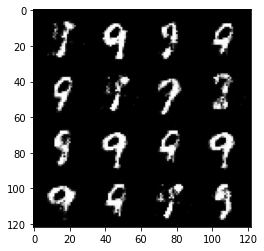

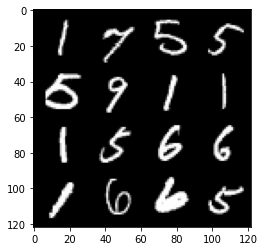

 90%|█████████ | 424/469 [00:11<00:01, 22.98it/s]

136: step 64200 / Gen loss: 2.913816600640615 / disc_loss: 0.18600542368988196


 53%|█████▎    | 247/469 [00:06<00:05, 37.87it/s]

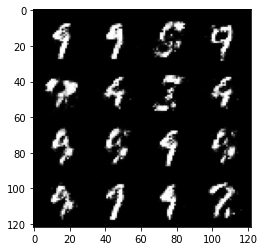

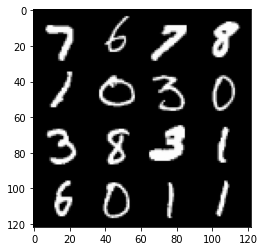

 54%|█████▍    | 255/469 [00:06<00:09, 22.38it/s]

137: step 64500 / Gen loss: 2.6503960474332167 / disc_loss: 0.20382129433254412


 17%|█▋        | 78/469 [00:01<00:09, 39.66it/s]

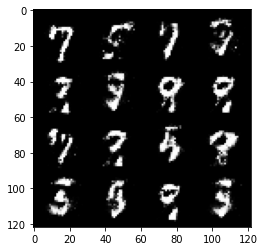

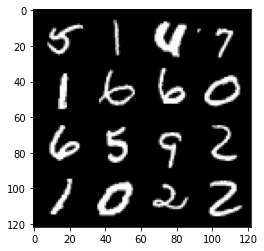

 17%|█▋        | 82/469 [00:02<00:19, 20.33it/s]

138: step 64800 / Gen loss: 2.858331252733866 / disc_loss: 0.18302294991910456


 80%|████████  | 376/469 [00:10<00:02, 37.21it/s]

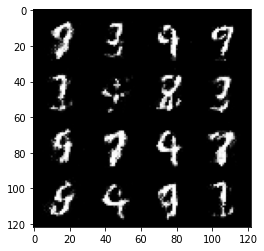

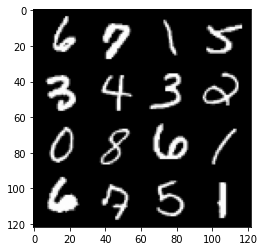

 82%|████████▏ | 384/469 [00:10<00:04, 20.41it/s]

138: step 65100 / Gen loss: 2.8198927537600196 / disc_loss: 0.19609861202538034


 44%|████▍     | 206/469 [00:05<00:06, 39.17it/s]

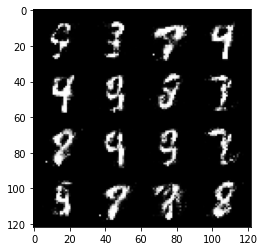

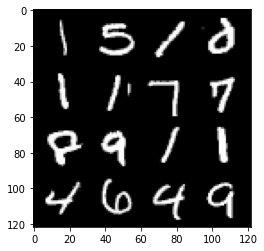

 46%|████▌     | 214/469 [00:05<00:11, 22.53it/s]

139: step 65400 / Gen loss: 2.6056922193368295 / disc_loss: 0.20326125256717198


  8%|▊         | 37/469 [00:00<00:11, 38.93it/s]

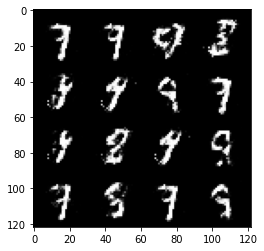

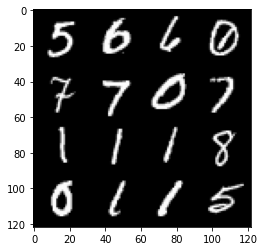

 10%|▉         | 45/469 [00:01<00:20, 20.27it/s]

140: step 65700 / Gen loss: 2.786011381149291 / disc_loss: 0.1750681947916746


 72%|███████▏  | 338/469 [00:09<00:03, 38.01it/s]

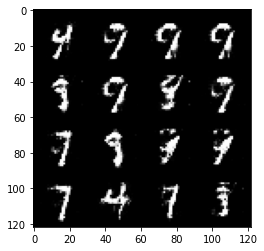

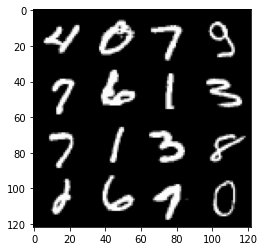

 74%|███████▍  | 347/469 [00:09<00:05, 23.90it/s]

140: step 66000 / Gen loss: 2.756537987391152 / disc_loss: 0.1869406193246443


 36%|███▌      | 169/469 [00:04<00:07, 39.80it/s]

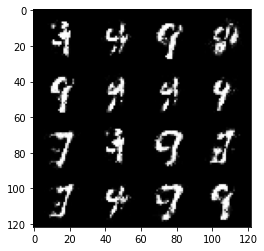

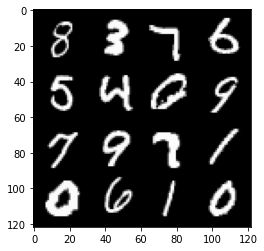

 38%|███▊      | 177/469 [00:04<00:12, 23.71it/s]

141: step 66300 / Gen loss: 2.708442979653674 / disc_loss: 0.1965616488456726


  0%|          | 0/469 [00:00<?, ?it/s]

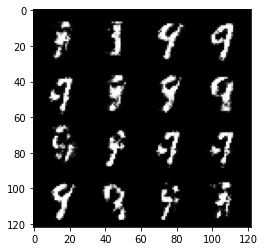

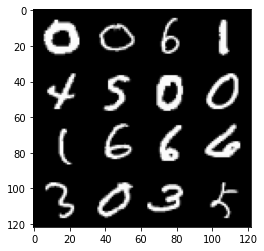

  1%|▏         | 7/469 [00:00<00:31, 14.73it/s]

142: step 66600 / Gen loss: 2.6918149948120127 / disc_loss: 0.18260924714306978


 64%|██████▍   | 301/469 [00:07<00:04, 39.36it/s]

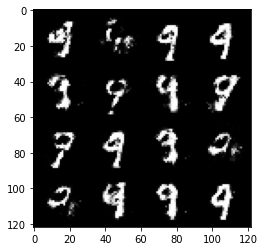

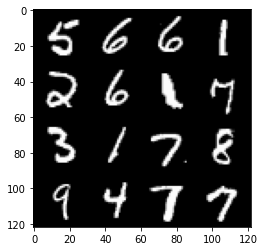

 66%|██████▌   | 309/469 [00:08<00:06, 23.67it/s]

142: step 66900 / Gen loss: 2.719278563658396 / disc_loss: 0.2036012393981218


 28%|██▊       | 133/469 [00:03<00:08, 38.01it/s]

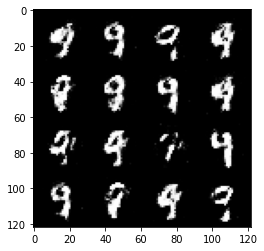

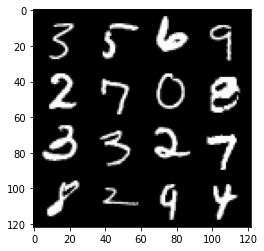

 30%|███       | 141/469 [00:04<00:15, 21.75it/s]

143: step 67200 / Gen loss: 2.601655655701955 / disc_loss: 0.19415739561120665


 92%|█████████▏| 433/469 [00:11<00:00, 39.55it/s]

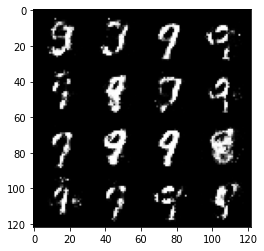

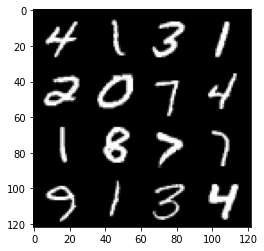

 94%|█████████▍| 441/469 [00:12<00:01, 23.43it/s]

143: step 67500 / Gen loss: 2.715249952475229 / disc_loss: 0.19161242648959173


 56%|█████▌    | 263/469 [00:06<00:05, 38.92it/s]

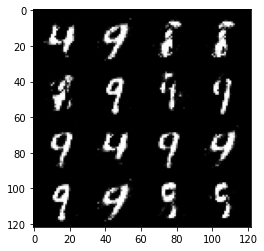

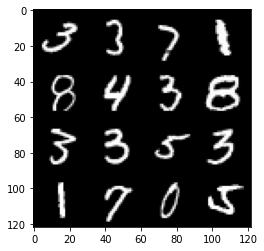

 58%|█████▊    | 271/469 [00:07<00:08, 22.28it/s]

144: step 67800 / Gen loss: 2.684532078107199 / disc_loss: 0.19509084644416969


 20%|█▉        | 92/469 [00:02<00:09, 38.59it/s]

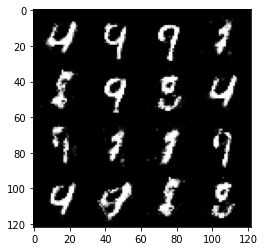

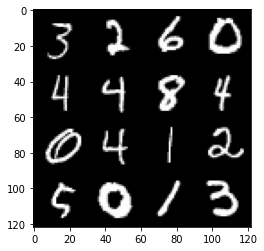

 22%|██▏       | 101/469 [00:03<00:17, 21.51it/s]

145: step 68100 / Gen loss: 2.7311606113115934 / disc_loss: 0.19571918219327925


 84%|████████▍ | 393/469 [00:10<00:01, 39.68it/s]

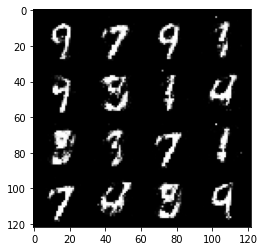

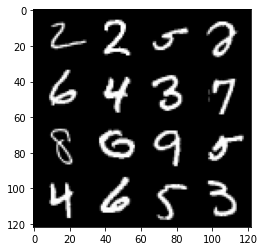

 86%|████████▌ | 401/469 [00:11<00:02, 23.28it/s]

145: step 68400 / Gen loss: 2.8300724260012333 / disc_loss: 0.18025335756440952


 48%|████▊     | 223/469 [00:05<00:06, 40.38it/s]

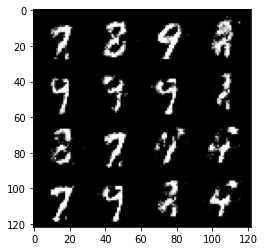

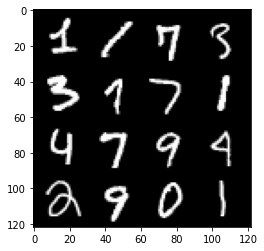

 50%|████▉     | 233/469 [00:06<00:09, 25.19it/s]

146: step 68700 / Gen loss: 2.7263973355293265 / disc_loss: 0.19013557540873682


 12%|█▏        | 55/469 [00:01<00:10, 39.64it/s]

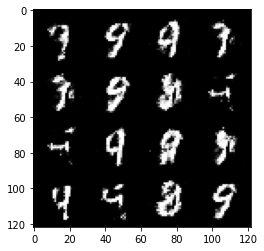

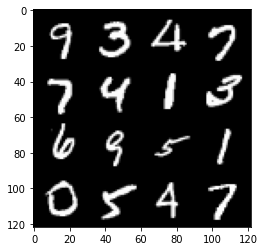

 14%|█▎        | 64/469 [00:01<00:17, 23.38it/s]

147: step 69000 / Gen loss: 2.6029455979665124 / disc_loss: 0.19828122615814217


 76%|███████▌  | 355/469 [00:09<00:02, 38.42it/s]

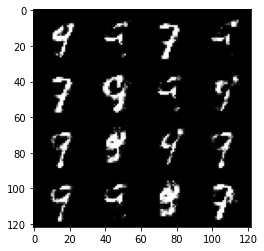

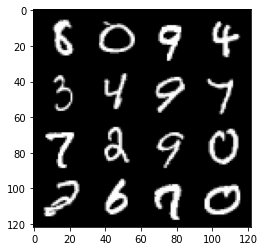

 77%|███████▋  | 363/469 [00:09<00:04, 22.64it/s]

147: step 69300 / Gen loss: 2.6331324855486553 / disc_loss: 0.18692513187726348


 40%|███▉      | 187/469 [00:04<00:06, 40.41it/s]

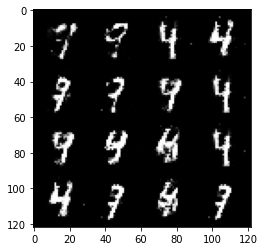

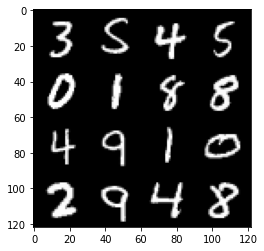

 42%|████▏     | 197/469 [00:05<00:10, 25.16it/s]

148: step 69600 / Gen loss: 2.9240069580078116 / disc_loss: 0.15337982714176182


  3%|▎         | 16/469 [00:00<00:11, 38.20it/s]

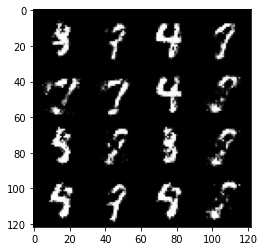

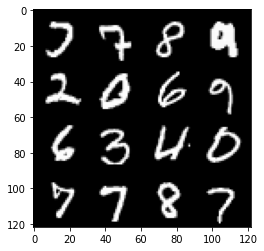

  5%|▌         | 24/469 [00:00<00:21, 21.17it/s]

149: step 69900 / Gen loss: 2.779775799910225 / disc_loss: 0.19175016579528645


 68%|██████▊   | 319/469 [00:08<00:03, 38.62it/s]

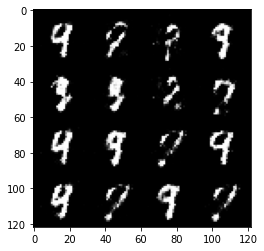

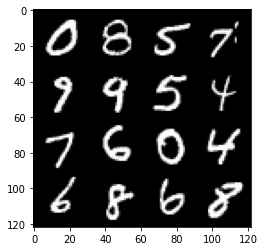

 70%|██████▉   | 328/469 [00:09<00:05, 24.01it/s]

149: step 70200 / Gen loss: 2.6954887223243698 / disc_loss: 0.1802033768594266


 32%|███▏      | 148/469 [00:03<00:08, 38.23it/s]

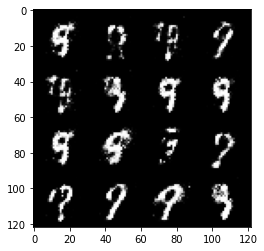

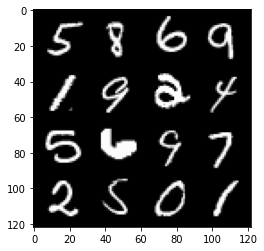

 33%|███▎      | 156/469 [00:04<00:15, 20.31it/s]

150: step 70500 / Gen loss: 2.883014996051789 / disc_loss: 0.15523313070336978


 95%|█████████▌| 447/469 [00:12<00:00, 39.53it/s]

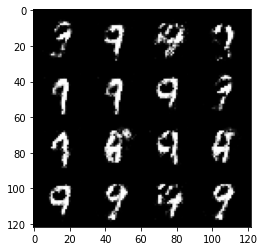

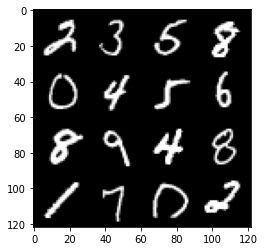

 97%|█████████▋| 455/469 [00:12<00:00, 22.73it/s]

150: step 70800 / Gen loss: 2.7026847298940013 / disc_loss: 0.1867687567820151


 59%|█████▉    | 278/469 [00:07<00:04, 38.85it/s]

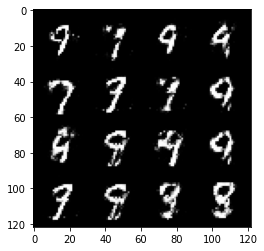

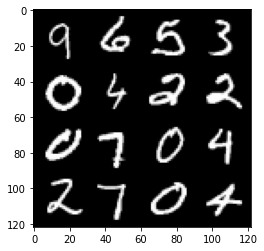

 61%|██████    | 286/469 [00:07<00:08, 22.69it/s]

151: step 71100 / Gen loss: 2.7701102256774877 / disc_loss: 0.1738755516956249


 23%|██▎       | 109/469 [00:02<00:09, 37.99it/s]

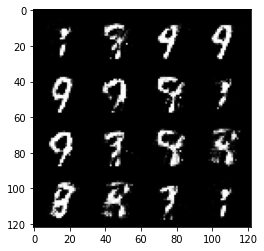

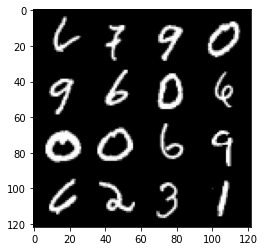

 25%|██▍       | 117/469 [00:03<00:15, 22.21it/s]

152: step 71400 / Gen loss: 2.864570237000783 / disc_loss: 0.16398322895169254


 87%|████████▋ | 409/469 [00:11<00:01, 38.43it/s]

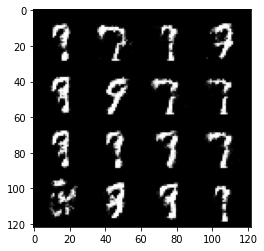

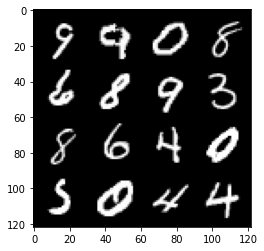

 89%|████████▉ | 417/469 [00:11<00:02, 22.53it/s]

152: step 71700 / Gen loss: 2.825512348810831 / disc_loss: 0.17528816839059197


 52%|█████▏    | 242/469 [00:06<00:05, 38.06it/s]

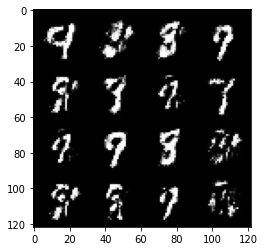

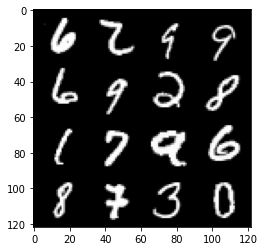

 53%|█████▎    | 250/469 [00:06<00:09, 22.54it/s]

153: step 72000 / Gen loss: 2.842435634136201 / disc_loss: 0.16133477650582786


 16%|█▌        | 74/469 [00:01<00:10, 39.13it/s]

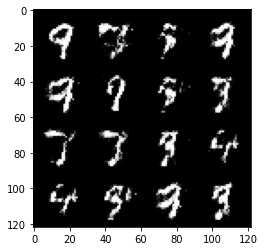

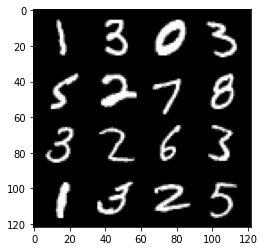

 18%|█▊        | 83/469 [00:02<00:15, 24.22it/s]

154: step 72300 / Gen loss: 2.8692017571131405 / disc_loss: 0.16410888498028123


 79%|███████▉  | 372/469 [00:10<00:02, 37.59it/s]

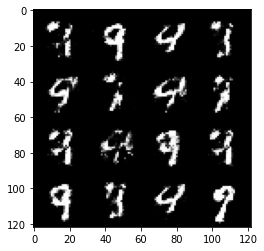

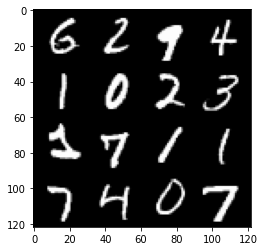

 81%|████████  | 380/469 [00:10<00:03, 22.58it/s]

154: step 72600 / Gen loss: 2.8995341451962777 / disc_loss: 0.17008070123692365


 44%|████▎     | 205/469 [00:05<00:06, 38.87it/s]

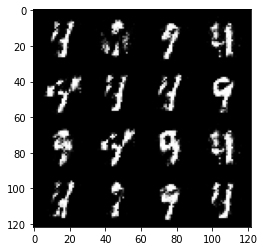

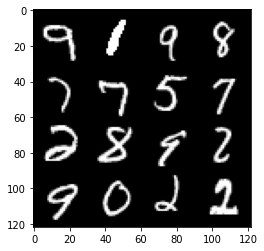

 45%|████▌     | 213/469 [00:05<00:12, 19.97it/s]

155: step 72900 / Gen loss: 2.7006081485748297 / disc_loss: 0.1995828455438217


  7%|▋         | 34/469 [00:00<00:11, 39.50it/s]

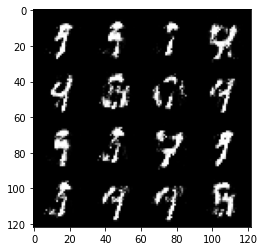

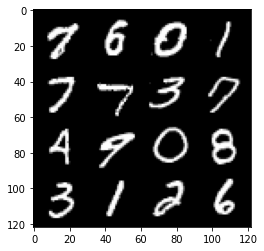

  9%|▉         | 42/469 [00:01<00:18, 22.59it/s]

156: step 73200 / Gen loss: 2.819870929718019 / disc_loss: 0.16522185715536267


 71%|███████▏  | 335/469 [00:08<00:03, 39.12it/s]

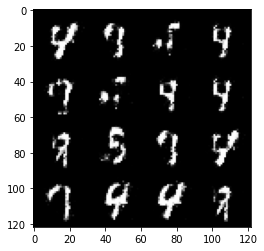

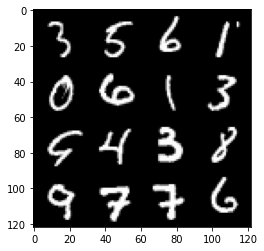

 73%|███████▎  | 343/469 [00:09<00:05, 23.33it/s]

156: step 73500 / Gen loss: 2.952695139249165 / disc_loss: 0.16838097423315057


 35%|███▌      | 166/469 [00:04<00:08, 37.11it/s]

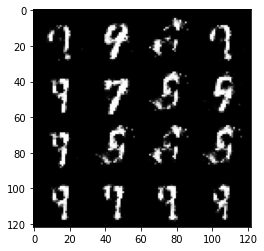

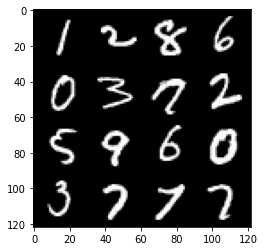

 37%|███▋      | 175/469 [00:04<00:12, 23.11it/s]

157: step 73800 / Gen loss: 2.7114368438720704 / disc_loss: 0.18443274197479093


 99%|█████████▉| 465/469 [00:12<00:00, 39.78it/s]

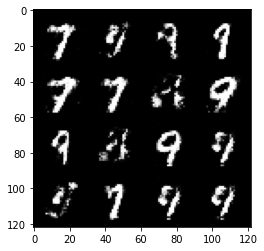

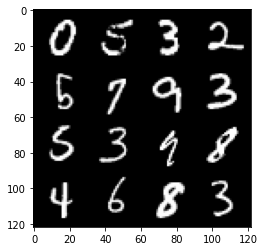

100%|██████████| 469/469 [00:12<00:00, 36.53it/s]


157: step 74100 / Gen loss: 2.7131649494171133 / disc_loss: 0.1790889333933591


 63%|██████▎   | 296/469 [00:07<00:04, 39.03it/s]

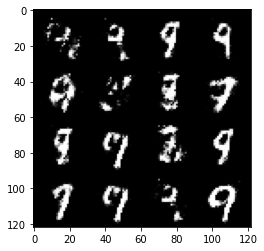

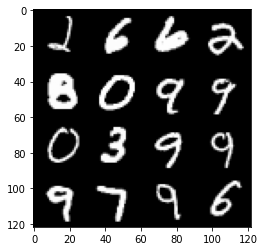

 65%|██████▍   | 304/469 [00:08<00:07, 22.69it/s]

158: step 74400 / Gen loss: 2.82294502099355 / disc_loss: 0.17774980309108884


 28%|██▊       | 129/469 [00:03<00:08, 37.99it/s]

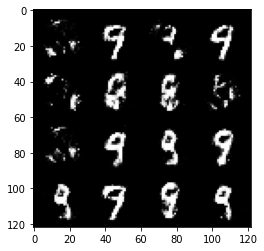

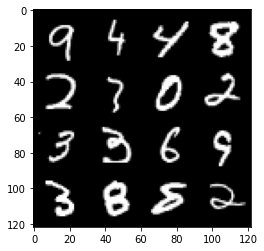

 29%|██▉       | 138/469 [00:03<00:14, 23.62it/s]

159: step 74700 / Gen loss: 2.955665507316589 / disc_loss: 0.16565196471909685


 91%|█████████ | 426/469 [00:11<00:01, 38.56it/s]

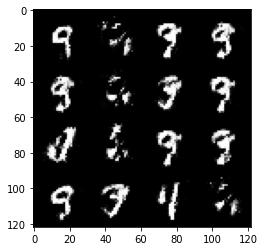

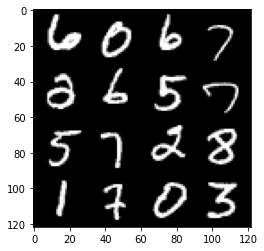

 93%|█████████▎| 434/469 [00:11<00:01, 20.84it/s]

159: step 75000 / Gen loss: 2.695587081114454 / disc_loss: 0.19394140385091302


 55%|█████▌    | 259/469 [00:06<00:05, 38.94it/s]

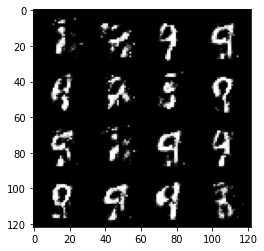

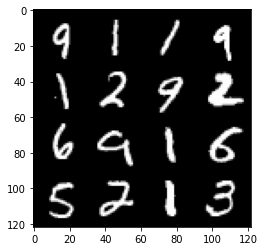

 57%|█████▋    | 267/469 [00:07<00:08, 23.40it/s]

160: step 75300 / Gen loss: 2.7208848762512208 / disc_loss: 0.17819404378533354


 19%|█▉        | 91/469 [00:02<00:10, 37.76it/s]

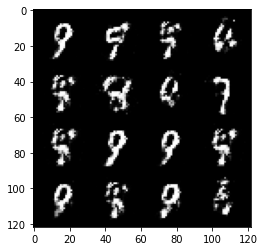

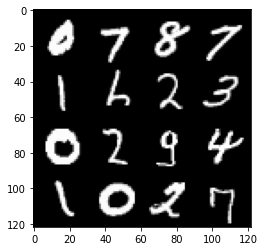

 21%|██▏       | 100/469 [00:02<00:15, 23.37it/s]

161: step 75600 / Gen loss: 2.6870746676127117 / disc_loss: 0.18931523757676275


 83%|████████▎ | 390/469 [00:10<00:01, 39.59it/s]

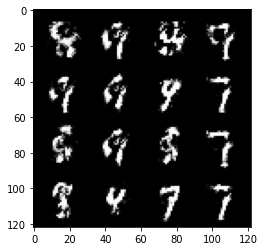

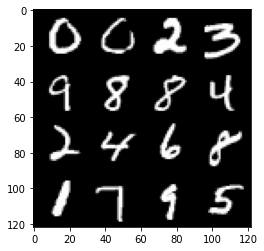

 85%|████████▍ | 398/469 [00:10<00:02, 23.93it/s]

161: step 75900 / Gen loss: 2.61458232720693 / disc_loss: 0.20194931482275325


 47%|████▋     | 222/469 [00:05<00:06, 38.68it/s]

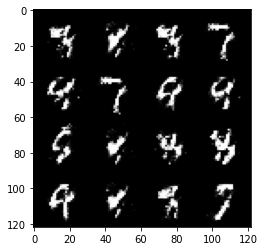

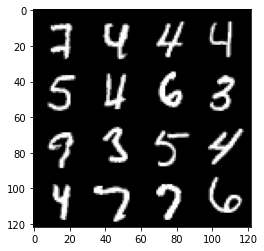

 49%|████▉     | 230/469 [00:06<00:10, 22.10it/s]

162: step 76200 / Gen loss: 2.616265665690105 / disc_loss: 0.18397025972604766


 11%|█         | 52/469 [00:01<00:11, 37.10it/s]

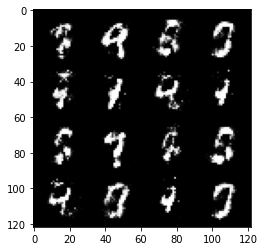

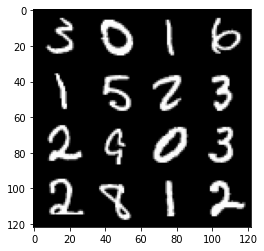

 13%|█▎        | 61/469 [00:01<00:17, 22.94it/s]

163: step 76500 / Gen loss: 2.756106637318929 / disc_loss: 0.19574747703969475


 75%|███████▍  | 350/469 [00:09<00:03, 38.09it/s]

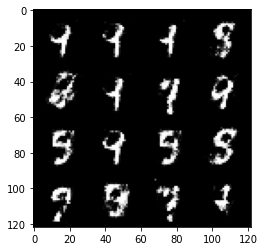

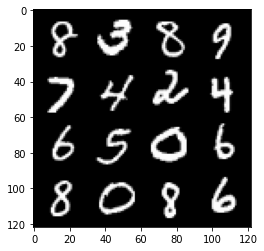

 76%|███████▋  | 358/469 [00:10<00:04, 22.47it/s]

163: step 76800 / Gen loss: 2.6507455619176215 / disc_loss: 0.17861323026319362


 39%|███▉      | 182/469 [00:04<00:07, 39.91it/s]

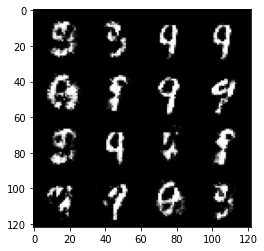

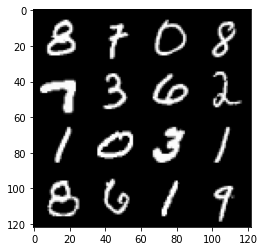

 41%|████      | 190/469 [00:05<00:11, 23.49it/s]

164: step 77100 / Gen loss: 2.6768864377339683 / disc_loss: 0.2065436663975316


  3%|▎         | 12/469 [00:00<00:12, 37.41it/s]

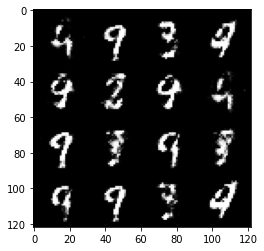

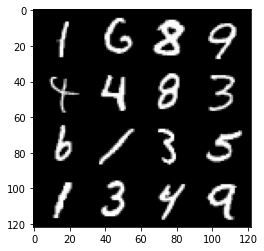

  4%|▍         | 20/469 [00:00<00:24, 18.63it/s]

165: step 77400 / Gen loss: 2.5127673300107305 / disc_loss: 0.20517276150484884


 67%|██████▋   | 313/469 [00:08<00:04, 38.33it/s]

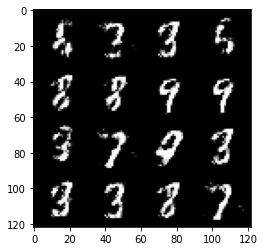

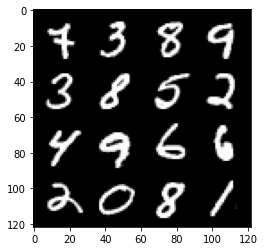

 68%|██████▊   | 321/469 [00:09<00:06, 23.04it/s]

165: step 77700 / Gen loss: 2.6471345218022666 / disc_loss: 0.1883556499332191


 31%|███       | 144/469 [00:03<00:08, 39.94it/s]

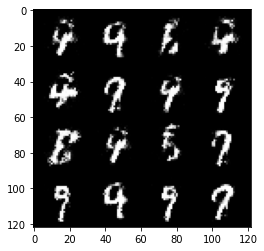

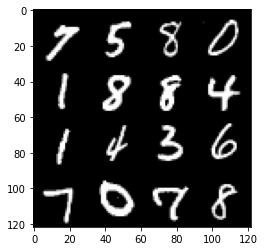

 32%|███▏      | 152/469 [00:04<00:13, 23.23it/s]

166: step 78000 / Gen loss: 2.594666412671406 / disc_loss: 0.2062858591228722


 95%|█████████▍| 445/469 [00:11<00:00, 38.07it/s]

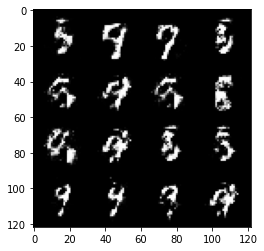

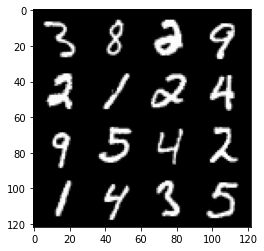

 97%|█████████▋| 454/469 [00:12<00:00, 22.95it/s]

166: step 78300 / Gen loss: 2.586796425183613 / disc_loss: 0.19617884442210173


 58%|█████▊    | 274/469 [00:07<00:05, 37.59it/s]

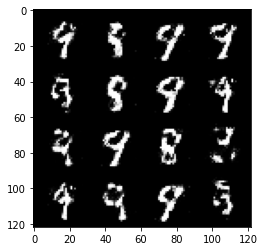

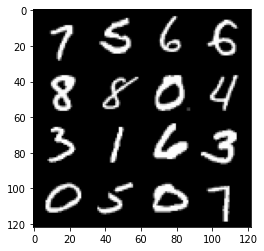

 60%|██████    | 282/469 [00:07<00:08, 22.45it/s]

167: step 78600 / Gen loss: 2.6952143192291262 / disc_loss: 0.18146568785111108


 22%|██▏       | 104/469 [00:02<00:09, 39.20it/s]

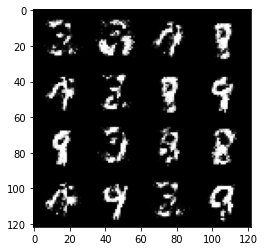

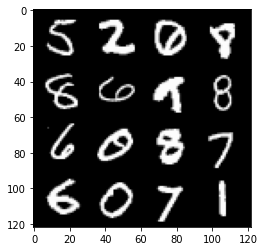

 24%|██▍       | 113/469 [00:03<00:14, 23.83it/s]

168: step 78900 / Gen loss: 2.7905353355407723 / disc_loss: 0.18148616087933375


 87%|████████▋ | 406/469 [00:10<00:01, 38.52it/s]

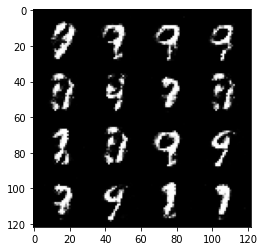

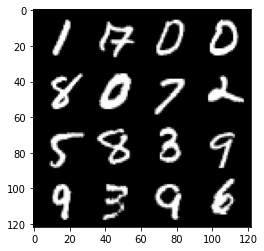

 88%|████████▊ | 414/469 [00:11<00:02, 22.43it/s]

168: step 79200 / Gen loss: 2.818742959499358 / disc_loss: 0.17723575236896674


 50%|█████     | 235/469 [00:06<00:06, 37.30it/s]

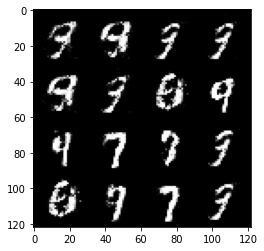

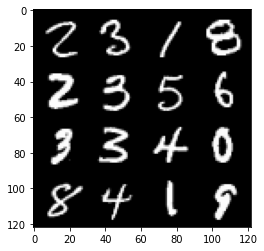

 52%|█████▏    | 244/469 [00:06<00:10, 21.53it/s]

169: step 79500 / Gen loss: 2.810121448834735 / disc_loss: 0.17888120782872038


 15%|█▍        | 69/469 [00:01<00:10, 37.99it/s]

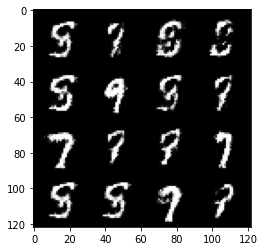

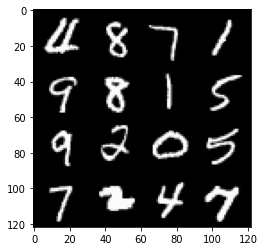

 17%|█▋        | 78/469 [00:02<00:18, 21.13it/s]

170: step 79800 / Gen loss: 2.618277748425803 / disc_loss: 0.1920290520290533


 79%|███████▉  | 370/469 [00:10<00:02, 38.79it/s]

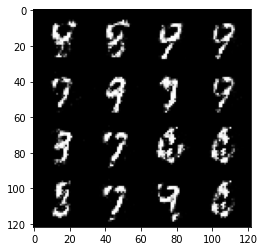

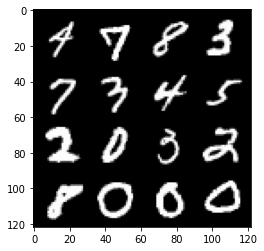

 81%|████████  | 379/469 [00:10<00:03, 23.47it/s]

170: step 80100 / Gen loss: 2.524071437517801 / disc_loss: 0.1969883044809103


 43%|████▎     | 200/469 [00:05<00:06, 40.32it/s]

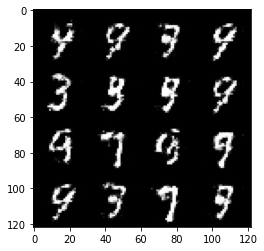

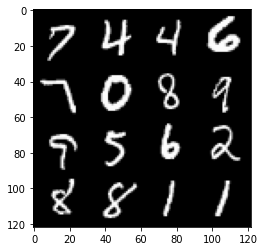

 45%|████▍     | 210/469 [00:05<00:10, 24.55it/s]

171: step 80400 / Gen loss: 2.640896291732785 / disc_loss: 0.18955591415365539


  7%|▋         | 31/469 [00:00<00:11, 38.95it/s]

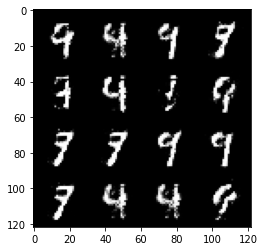

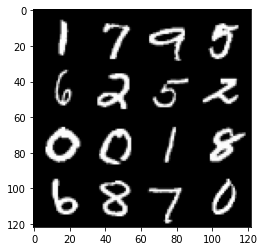

  8%|▊         | 39/469 [00:01<00:19, 21.95it/s]

172: step 80700 / Gen loss: 2.473538473447165 / disc_loss: 0.2150842711826167


 71%|███████   | 332/469 [00:08<00:03, 39.29it/s]

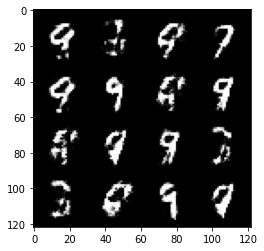

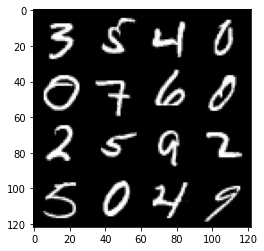

 72%|███████▏  | 340/469 [00:09<00:05, 22.43it/s]

172: step 81000 / Gen loss: 2.526342110633851 / disc_loss: 0.21791456793745362


 34%|███▍      | 160/469 [00:04<00:07, 39.52it/s]

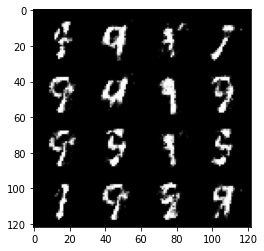

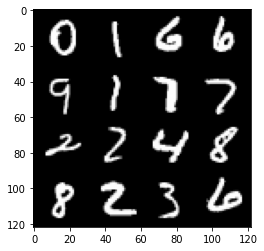

 36%|███▌      | 168/469 [00:04<00:13, 22.58it/s]

173: step 81300 / Gen loss: 2.695881441434223 / disc_loss: 0.19170743048191077


 98%|█████████▊| 461/469 [00:12<00:00, 39.04it/s]

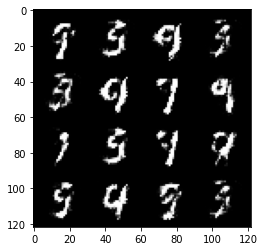

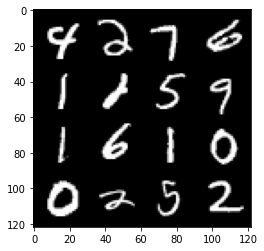

100%|██████████| 469/469 [00:12<00:00, 37.29it/s]


173: step 81600 / Gen loss: 2.591275501251223 / disc_loss: 0.19914041578769687


 62%|██████▏   | 290/469 [00:07<00:04, 40.76it/s]

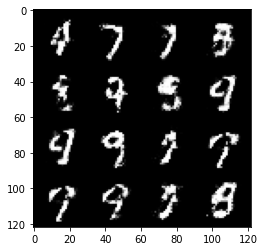

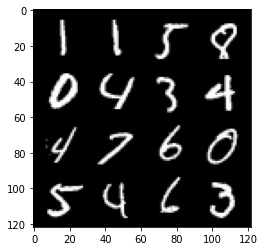

 64%|██████▍   | 299/469 [00:08<00:07, 24.03it/s]

174: step 81900 / Gen loss: 2.5948942788441984 / disc_loss: 0.1961172664165497


 26%|██▋       | 124/469 [00:03<00:08, 39.29it/s]

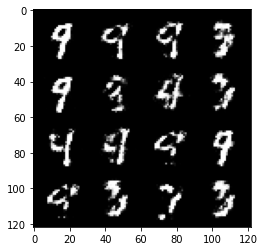

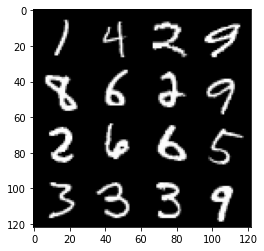

 28%|██▊       | 133/469 [00:03<00:15, 21.16it/s]

175: step 82200 / Gen loss: 2.5838264369964574 / disc_loss: 0.21202752975126085


 90%|████████▉ | 422/469 [00:11<00:01, 36.80it/s]

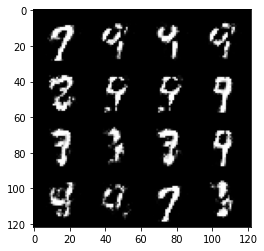

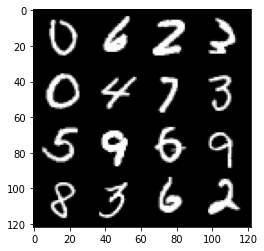

 92%|█████████▏| 430/469 [00:11<00:01, 22.16it/s]

175: step 82500 / Gen loss: 2.4699354561169926 / disc_loss: 0.21592568854490915


 54%|█████▍    | 255/469 [00:06<00:05, 39.53it/s]

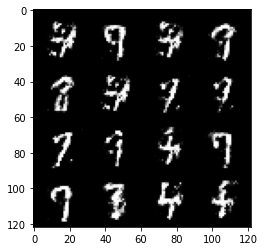

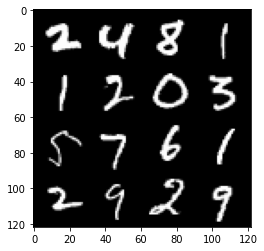

 56%|█████▌    | 263/469 [00:06<00:08, 22.90it/s]

176: step 82800 / Gen loss: 2.4550236145655306 / disc_loss: 0.21200967294474432


 18%|█▊        | 86/469 [00:02<00:09, 38.47it/s]

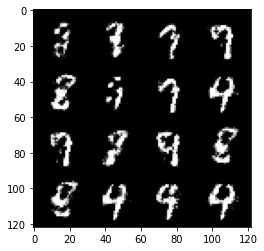

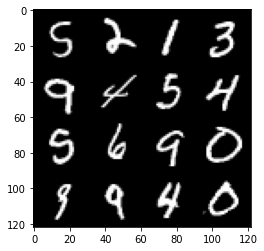

 20%|██        | 95/469 [00:02<00:15, 23.89it/s]

177: step 83100 / Gen loss: 2.5438812486330655 / disc_loss: 0.19213639917472994


 82%|████████▏ | 385/469 [00:10<00:02, 39.15it/s]

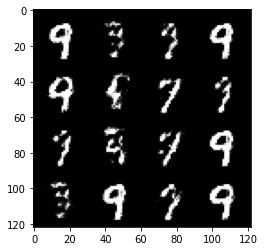

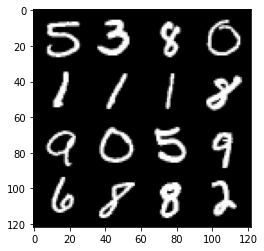

 84%|████████▍ | 394/469 [00:10<00:03, 23.64it/s]

177: step 83400 / Gen loss: 2.6413569347063697 / disc_loss: 0.1806577323873836


 46%|████▌     | 215/469 [00:05<00:06, 38.26it/s]

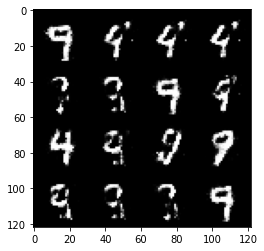

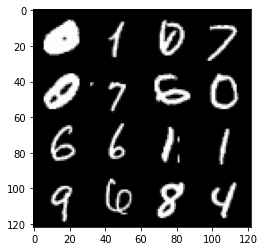

 48%|████▊     | 223/469 [00:06<00:10, 23.11it/s]

178: step 83700 / Gen loss: 2.4262818769613905 / disc_loss: 0.23072784823675963


 10%|█         | 49/469 [00:01<00:10, 39.02it/s]

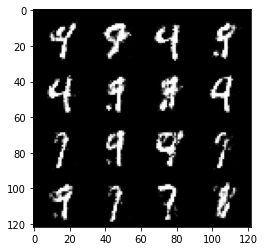

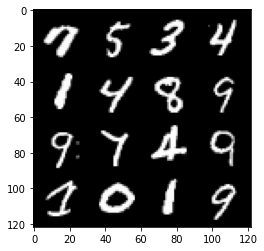

 12%|█▏        | 57/469 [00:01<00:18, 22.84it/s]

179: step 84000 / Gen loss: 2.4129029361406977 / disc_loss: 0.21209244812528305


 74%|███████▍  | 346/469 [00:09<00:03, 38.79it/s]

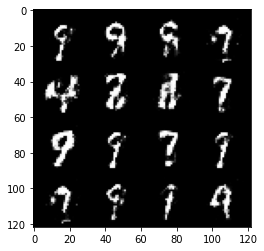

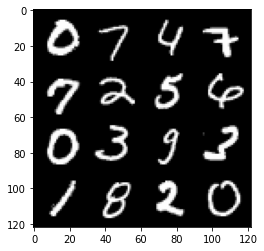

 75%|███████▌  | 354/469 [00:09<00:05, 20.49it/s]

179: step 84300 / Gen loss: 2.366911742289863 / disc_loss: 0.21958376089731851


 38%|███▊      | 177/469 [00:04<00:07, 39.59it/s]

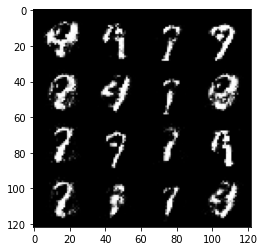

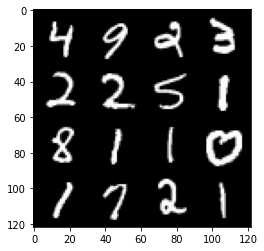

 39%|███▉      | 185/469 [00:05<00:12, 23.18it/s]

180: step 84600 / Gen loss: 2.4033885145187384 / disc_loss: 0.21353018601735432


  2%|▏         | 9/469 [00:00<00:11, 38.85it/s]

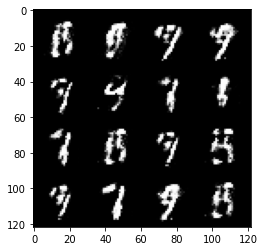

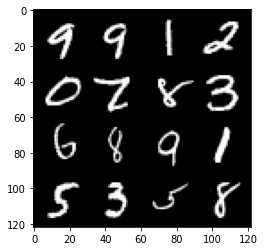

  4%|▎         | 17/469 [00:00<00:22, 20.18it/s]

181: step 84900 / Gen loss: 2.4049758986632006 / disc_loss: 0.21129970118403424


 66%|██████▌   | 309/469 [00:08<00:04, 39.07it/s]

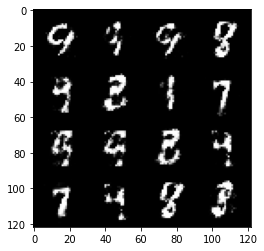

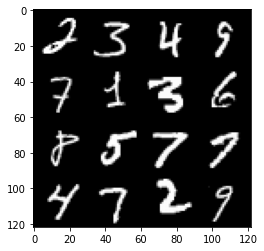

 68%|██████▊   | 317/469 [00:08<00:06, 23.44it/s]

181: step 85200 / Gen loss: 2.274392668008806 / disc_loss: 0.23677560751636828


 30%|██▉       | 139/469 [00:03<00:08, 39.05it/s]

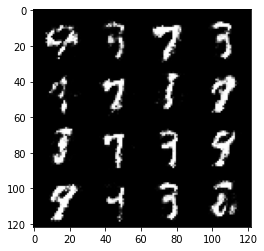

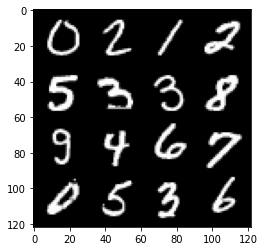

 31%|███▏      | 147/469 [00:04<00:13, 23.09it/s]

182: step 85500 / Gen loss: 2.355015200773875 / disc_loss: 0.2361418155829111


 94%|█████████▍| 442/469 [00:11<00:00, 39.35it/s]

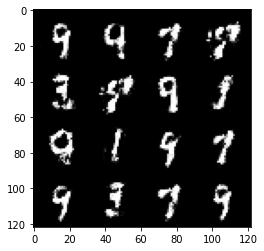

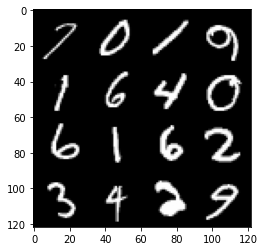

 96%|█████████▌| 450/469 [00:12<00:00, 22.65it/s]

182: step 85800 / Gen loss: 2.37757574836413 / disc_loss: 0.22737362556159493


 58%|█████▊    | 273/469 [00:07<00:05, 36.49it/s]

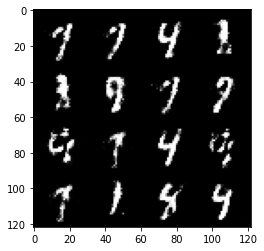

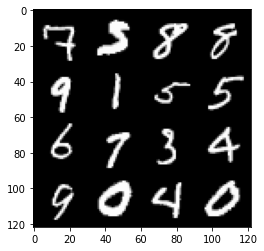

 60%|█████▉    | 281/469 [00:07<00:08, 21.58it/s]

183: step 86100 / Gen loss: 2.604880468845369 / disc_loss: 0.20325537415842204


 22%|██▏       | 102/469 [00:02<00:09, 40.63it/s]

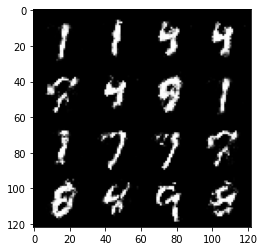

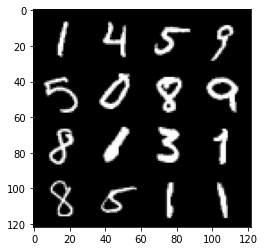

 24%|██▍       | 112/469 [00:03<00:14, 25.16it/s]

184: step 86400 / Gen loss: 2.2744845012823727 / disc_loss: 0.23291630536317823


 86%|████████▌ | 403/469 [00:10<00:01, 39.63it/s]

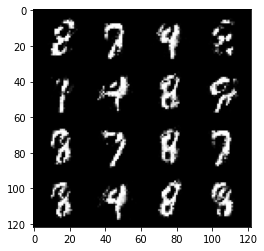

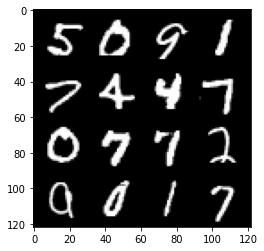

 88%|████████▊ | 411/469 [00:11<00:02, 21.58it/s]

184: step 86700 / Gen loss: 2.1932090298334765 / disc_loss: 0.25690019617478055


  1%|          | 4/469 [00:00<00:12, 38.72it/s]

In [ ]:
# 60000 / 128 = 468.75 = 469 steps in each epoch
# Each step is going to process 128 images = size of the batch (except the last step)

for epoch in range(epochs):
  for real, _ in tqdm(dataloader):

    ## Discriminator
    disc_opt.zero_grad()

    cur_bs= len(real)
    real =real.view(cur_bs, -1)
    real = real.to(device)

    disc_loss = calc_disc_loss(loss_func,gen,disc,cur_bs,real,z_dim)

    disc_loss.backward(retain_graph=True)
    disc_opt.step()

    ## Generator
    gen_opt.zero_grad()
    gen_loss = calc_gen_loss(loss_func,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opt.step()

    ## Visualization & stats

    mean_disc_loss += disc_loss.item()/info_step
    mean_gen_loss += gen_loss.item()/info_step

    if cur_step % info_step == 0 and cur_step>0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step} / Gen loss: {mean_gen_loss} / disc_loss: {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0, 0
    cur_step += 1